In [2]:
import scanpy as sc
import pandas as pd 
import numpy as np
from scipy.sparse import csr_matrix
import matplotlib.pyplot as plt
import warnings
#from nero import Harmonia

In [3]:
# might need this, the most recent version of jupterlab I installed installed the most recent version of jedi which has been having problems with autocomplete
# see thread here: https://github.com/ipython/ipython/issues/10493
%config Completer.use_jedi = False

sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)

In [3]:
prefix = '/data/jupyter/'

#HTO_classification = pd.read_csv('/wynton/group/ye/byungjin/mux_abseq/191224_novaseq/191205_v1_1_hm_1um_HTO_classification.csv',sep=',')

In [4]:
h5_path = prefix + '200K_PBMC_filtered_feature_bc_matrix.h5'
# demux_path = prefix + 'cramore/demux.output.best'
vireo_path = prefix + '200K_PBMC_donor_ids.tsv'

In [5]:
#mymux = Harmonia.MuxOut(demux_path)
mymux = Harmonia.MuxOut(vireo_path)

In [6]:
print(mymux.num_drops)
print(mymux.sngrate)
print(mymux.dblrate)
print(mymux.ambrate)

49511
0.5331138534871038
0.44994041728100825
0.016945729231887863


In [7]:
raw_adata = sc.read_10x_h5(h5_path, gex_only=False) # need gex_only = False otherwise the custom feature barcodes don't show up
raw_adata.var_names_make_unique()

reading /data/jupyter/200K_PBMC_filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:04)


In [8]:
adata = raw_adata.copy()

Extract out singlets and doublets only.

In [9]:
sngdbls = mymux.sngdbl()[['DROPLET.TYPE','BEST.GUESS']]
cells = sngdbls.loc[np.intersect1d(adata.obs_names.values,
                                   sngdbls.index.values,
                                   assume_unique=True),:]

Subset for singlets and doublets, and make some useful covariates.

In [10]:
cell_adata = adata[cells.index].copy()
cell_adata.obs['DROPTYPE'] = cells['DROPLET.TYPE']
cell_adata.obs['IND'] = cells['BEST.GUESS']

Remove platelets and RBCs.

In [11]:
mat = csr_matrix(cell_adata.X) # convert the underlying data matrix into a compressed sparse row matrix
mat = np.array(mat[:, cell_adata.var_names.isin(['PPBP'])].todense()).flatten() # get the counts of PPBP in each cell`
counts, nums = np.unique(mat,return_counts=True) #confirm we won't lose all of our cells
list(zip(nums,counts))

[(45052, 0.0),
 (2609, 1.0),
 (282, 2.0),
 (109, 3.0),
 (61, 4.0),
 (46, 5.0),
 (36, 6.0),
 (42, 7.0),
 (26, 8.0),
 (25, 9.0),
 (21, 10.0),
 (18, 11.0),
 (30, 12.0),
 (13, 13.0),
 (20, 14.0),
 (17, 15.0),
 (10, 16.0),
 (25, 17.0),
 (24, 18.0),
 (13, 19.0),
 (13, 20.0),
 (7, 21.0),
 (9, 22.0),
 (9, 23.0),
 (10, 24.0),
 (6, 25.0),
 (5, 26.0),
 (5, 27.0),
 (8, 28.0),
 (7, 29.0),
 (2, 30.0),
 (5, 31.0),
 (3, 32.0),
 (4, 33.0),
 (5, 34.0),
 (3, 35.0),
 (5, 36.0),
 (8, 37.0),
 (4, 38.0),
 (3, 39.0),
 (1, 40.0),
 (3, 41.0),
 (3, 42.0),
 (1, 43.0),
 (3, 44.0),
 (1, 45.0),
 (2, 46.0),
 (5, 47.0),
 (1, 48.0),
 (2, 50.0),
 (1, 51.0),
 (2, 52.0),
 (2, 53.0),
 (1, 54.0),
 (4, 55.0),
 (3, 56.0),
 (2, 57.0),
 (2, 58.0),
 (1, 59.0),
 (1, 60.0),
 (1, 61.0),
 (1, 62.0),
 (2, 64.0),
 (2, 65.0),
 (1, 66.0),
 (1, 68.0),
 (2, 70.0),
 (2, 72.0),
 (1, 74.0),
 (1, 76.0),
 (1, 77.0),
 (1, 78.0),
 (1, 80.0),
 (1, 81.0),
 (1, 85.0),
 (2, 94.0),
 (1, 100.0),
 (1, 101.0),
 (1, 105.0),
 (1, 106.0),
 (1, 108.0),
 (1,

In [12]:
cell_adata = cell_adata[mat <= 1].copy()

In [13]:
mat = csr_matrix(cell_adata.X) # convert the underlying data matrix into a compressed sparse row matrix
mat = np.array(mat[:, cell_adata.var_names.isin(['HBB'])].todense()).flatten() # get the counts of PPBP in each cell`
counts, nums = np.unique(mat,return_counts=True) #confirm we won't lose all of our cells
list(zip(nums,counts))

[(47370, 0.0),
 (253, 1.0),
 (7, 2.0),
 (3, 3.0),
 (1, 6.0),
 (2, 12.0),
 (1, 25.0),
 (1, 39.0),
 (1, 44.0),
 (1, 53.0),
 (1, 66.0),
 (1, 67.0),
 (1, 74.0),
 (1, 117.0),
 (1, 136.0),
 (1, 180.0),
 (1, 208.0),
 (1, 227.0),
 (1, 232.0),
 (1, 244.0),
 (1, 253.0),
 (1, 267.0),
 (1, 287.0),
 (1, 451.0),
 (1, 470.0),
 (1, 664.0),
 (1, 747.0),
 (1, 1440.0),
 (1, 1650.0),
 (1, 1902.0),
 (1, 2062.0)]

In [14]:
cell_adata = cell_adata[mat <= 1].copy()

Get percentage mitochondria.

In [15]:
genelist = cell_adata.var_names.tolist()
mito_genes_names = [gn for gn in genelist if gn.startswith('MT-')]
mito_genes = [genelist.index(gn) for gn in mito_genes_names]
cell_adata.obs['percent_mito'] = np.ravel(np.sum(cell_adata[:, mito_genes].X, axis=1)) / np.ravel(np.sum(cell_adata.X, axis=1))

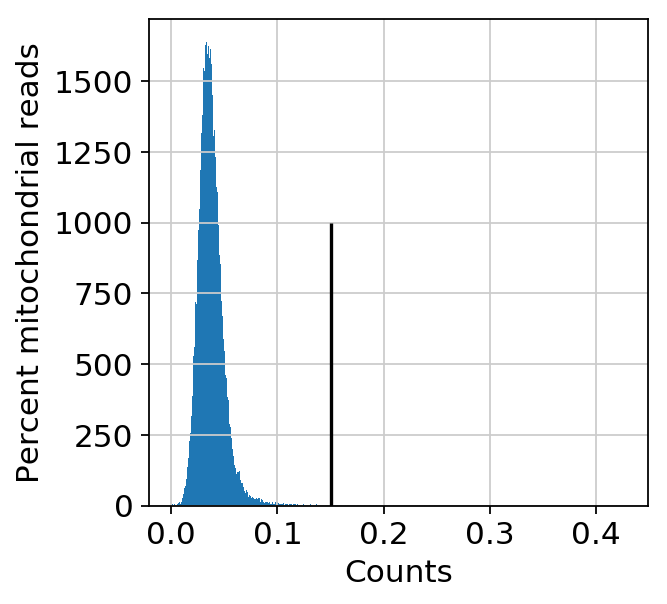

In [16]:
plt.hist(cell_adata.obs['percent_mito'].values,bins=500)
plt.vlines(0.15,0,1000);
plt.xlabel('Counts')
plt.ylabel('Percent mitochondrial reads');
# plt.xlim((0,0.1));

Only keep cells with low `percent_mito`.

In [17]:
cutoff = 0.15
cell_adata = cell_adata[cell_adata.obs['percent_mito'] < cutoff].copy()

In [18]:
cell_adata

AnnData object with n_obs × n_vars = 47571 × 33818 
    obs: 'DROPTYPE', 'IND', 'percent_mito'
    var: 'gene_ids', 'feature_types', 'genome'

Examine the number of genes expressed per cell.

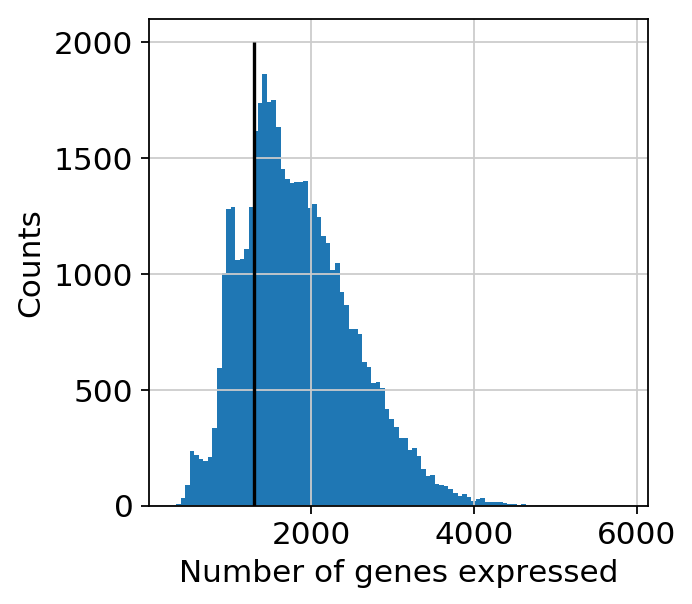

In [19]:
plt.hist(sc.pp.filter_cells(cell_adata, min_genes=0,inplace=False)[1],bins=100); # just to get out the number of genes expressed per cell
plt.ylabel('Counts')
plt.xlabel('Number of genes expressed');
plt.vlines(1300,0,2000);

I won't filter anything out here, but this may very well be a gauge for the doublets.

Standard processing here:

In [20]:
sc.pp.filter_genes(cell_adata,min_counts=1)

filtered out 8833 genes that are detected in less than 1 counts


In [21]:
cell_adata.var

,gene_ids,feature_types,genome,n_counts
AL627309.1,ENSG00000238009,Gene Expression,GRCh38,57.0
AL627309.3,ENSG00000239945,Gene Expression,GRCh38,4.0
AL627309.4,ENSG00000241599,Gene Expression,GRCh38,22.0
AL669831.2,ENSG00000229905,Gene Expression,GRCh38,8.0
AL669831.5,ENSG00000237491,Gene Expression,GRCh38,4058.0
...,...,...,...,...
TCR_Va24-Ja18_barcode10,Ab10TCR_Va24-Ja18,Antibody Capture,,20563.0
CD38_barcode10,Ab10CD38,Antibody Capture,,38460.0
HLA_DR_barcode10,Ab10HLA_DR,Antibody Capture,,104192.0
PD-1_barcode10,Ab10PD-1,Antibody Capture,,201331.0


In [22]:
cell_adata

AnnData object with n_obs × n_vars = 47571 × 24985 
    obs: 'DROPTYPE', 'IND', 'percent_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'

In [23]:
adata.var.tail(29)

,gene_ids,feature_types,genome
CD56_barcode9,Ab9CD56,Antibody Capture,
CD45_barcode10,Ab10CD45,Antibody Capture,
CD235_barcode10,Ab10CD235,Antibody Capture,
CD61_barcode10,Ab10CD61,Antibody Capture,
CD33_barcode10,Ab10CD33,Antibody Capture,
CD3_barcode10,Ab10CD3,Antibody Capture,
CD19_barcode10,Ab10CD19,Antibody Capture,
CD117_barcode10,Ab10CD117,Antibody Capture,
CD11b_barcode10,Ab10CD11b,Antibody Capture,
CD4_barcode10,Ab10CD4,Antibody Capture,


In [24]:
cell_adata_p = cell_adata[:,cell_adata.var.index[-280:]]


a=np.sum(cell_adata[:,cell_adata_p.var.index[:28]].X, axis=1)
b=np.sum(cell_adata[:,cell_adata_p.var.index[28:56]].X, axis=1)
c=np.sum(cell_adata[:,cell_adata_p.var.index[56:84]].X, axis=1)
d=np.sum(cell_adata[:,cell_adata_p.var.index[84:112]].X, axis=1)
e=np.sum(cell_adata[:,cell_adata_p.var.index[112:140]].X, axis=1)
f=np.sum(cell_adata[:,cell_adata_p.var.index[140:168]].X,axis=1)
g=np.sum(cell_adata[:,cell_adata_p.var.index[168:196]].X,axis=1)
h=np.sum(cell_adata[:,cell_adata_p.var.index[196:224]].X,axis=1)
i=np.sum(cell_adata[:,cell_adata_p.var.index[224:252]].X,axis=1)
j=np.sum(cell_adata[:,cell_adata_p.var.index[252:280]].X,axis=1)



t = (cell_adata_p.copy().T).X.toarray()
pd.DataFrame(data=t).to_csv('ab_raw_200K_matix.csv', columns=None)
#np.savetxt("ab_raw_100K_matrix.txt", ab_raw_array)
#ab_raw_df.to_csv("ab_raw_100K_matrix.txt", header=False)

ab_hashtag= np.concatenate((a,b,c,d,e,f,g,h,i,j), axis=1)
ab_hashtag_df = pd.DataFrame(ab_hashtag.T)

ab_hashtag_df.to_csv("ab_merge_batch_200K_matrix.txt",header=False)
#np.savetxt('ab_merge_batch_100K_matrix.txt', ab_hashtag.T)


In [26]:
CD45ab = [x for x in cell_adata.var.index if x.startswith("CD45_")]
CD235ab = [x for x in cell_adata.var.index if x.startswith("CD235")]
CD61ab = [x for x in cell_adata.var.index if x.startswith("CD61")]
CD33ab = [x for x in cell_adata.var.index if x.startswith("CD33_")]
CD3ab = [x for x in cell_adata.var.index if x.startswith("CD3_")]
CD19ab = [x for x in cell_adata.var.index if x.startswith("CD19_")]
CD117ab = [x for x in cell_adata.var.index if x.startswith("CD117")]
CD11bab = [x for x in cell_adata.var.index if x.startswith("CD11b")]
CD4ab = [x for x in cell_adata.var.index if x.startswith("CD4_")]
Cd8aab = [x for x in cell_adata.var.index if x.startswith("Cd8a")]
CD11cab = [x for x in cell_adata.var.index if x.startswith("CD11c")]
CD14ab = [x for x in cell_adata.var.index if x.startswith("CD14_")]
CD127ab = [x for x in cell_adata.var.index if x.startswith("CD127")]
FCER1ab = [x for x in cell_adata.var.index if x.startswith("FcER1")]
CD123ab = [x for x in cell_adata.var.index if x.startswith("CD123")]
gdTCRab = [x for x in cell_adata.var.index if x.startswith("gdTCR")]
CD45RAab = [x for x in cell_adata.var.index if x.startswith("CD45RA")]
TIM3ab = [x for x in cell_adata.var.index if x.startswith("TIM3")]
PDL1ab = [x for x in cell_adata.var.index if x.startswith("PDL1")]
CD27ab = [x for x in cell_adata.var.index if x.startswith("CD27_")]
CD45ROab = [x for x in cell_adata.var.index if x.startswith("CD45RO")]
CCR7ab = [x for x in cell_adata.var.index if x.startswith("CCR7_")]
CD25ab = [x for x in cell_adata.var.index if x.startswith("CD25")]
TCR_Va24_Ja18ab = [x for x in cell_adata.var.index if x.startswith("TCR_Va24-Ja18")]
CD38ab = [x for x in cell_adata.var.index if x.startswith("CD38_")]
HLA_DRab = [x for x in cell_adata.var.index if x.startswith("HLA_DR")]
PD1ab = [x for x in cell_adata.var.index if x.startswith("PD-1")]
CD56ab = [x for x in cell_adata.var.index if x.startswith("CD56")]

a=cell_adata[:,CD45ab].to_df()
a.columns=['total_CD45_barcode1', 'total_CD45_barcode2', 'total_CD45_barcode3','total_CD45_barcode4', 'total_CD45_barcode5', 'total_CD45_barcode6', 'total_CD45_barcode7', 'total_CD45_barcode8', 'total_CD45_barcode9', 'total_CD45_barcode10']
b=cell_adata[:,CD235ab].to_df()
c=cell_adata[:,CD61ab].to_df()
d=cell_adata[:,CD33ab].to_df()
e=cell_adata[:,CD3ab].to_df()
f=cell_adata[:,CD19ab].to_df()
g=cell_adata[:,CD117ab].to_df()
h=cell_adata[:,CD11bab].to_df()
i=cell_adata[:,CD4ab].to_df()

j=cell_adata[:,Cd8aab].to_df()
k=cell_adata[:,CD11cab].to_df()
l=cell_adata[:,CD14ab].to_df()
m=cell_adata[:,CD127ab].to_df()
n=cell_adata[:,FCER1ab].to_df()
o=cell_adata[:,CD123ab].to_df()
p=cell_adata[:,gdTCRab].to_df()
q=cell_adata[:,CD45RAab].to_df()
q.columns=['RA_CD45_barcode1', 'RA_CD45_barcode2', 'RA_CD45_barcode3','RA_CD45_barcode4', 'RA_CD45_barcode5', 'RA_CD45_barcode6', 'RA_CD45_barcode7', 'RA_CD45_barcode8', 'RA_CD45_barcode9', 'RA_CD45_barcode10']
r=cell_adata[:,TIM3ab].to_df()
s=cell_adata[:,PDL1ab].to_df()
t=cell_adata[:,CD27ab].to_df()
u=cell_adata[:,CD45ROab].to_df()
u.columns=['RO_CD45_barcode1', 'RO_CD45_barcode2', 'RO_CD45_barcode3','RO_CD45_barcode4', 'RO_CD45_barcode5', 'RO_CD45_barcode6', 'RO_CD45_barcode7', 'RO_CD45_barcode8', 'RO_CD45_barcode9', 'RO_CD45_barcode10']
v=cell_adata[:,CCR7ab].to_df()
w=cell_adata[:,CD25ab].to_df()
x=cell_adata[:,TCR_Va24_Ja18ab].to_df()
y=cell_adata[:,CD38ab].to_df()
z=cell_adata[:,HLA_DRab].to_df()
aa=cell_adata[:,PD1ab].to_df()
bb=cell_adata[:,CD56ab].to_df()


total_df = a.join([b,c,d,e,f,g,h,i,j,k,l,m,n,o,p,q,r,s,t,u,v,w,x,y,z,aa,bb])
#total_df = pd.concat([a,b,c,d,e,f,g,h,i,j,k,l,m,n,o,p,q,r,s,t,u,v,w,x,y,z,aa,bb], axis=0, join='outer', ignore_index=True)


A = pd.DataFrame(a.sum(axis=1), columns=['CD45_merged'])
B = pd.DataFrame(b.sum(axis=1), columns=['CD235_merged'])
C= pd.DataFrame(c.sum(axis=1), columns=['CD61_merged'])
D= pd.DataFrame(d.sum(axis=1), columns=['CD33_merged'])
E = pd.DataFrame(e.sum(axis=1), columns=['CD3_merged'])
F = pd.DataFrame(f.sum(axis=1), columns=['CD19_merged'])
G= pd.DataFrame(g.sum(axis=1), columns=['CD117_merged'])
H= pd.DataFrame(h.sum(axis=1), columns=['CD11b_merged'])
I = pd.DataFrame(i.sum(axis=1), columns=['CD4_merged'])
J = pd.DataFrame(j.sum(axis=1), columns=['CD8a_merged'])
K = pd.DataFrame(k.sum(axis=1), columns=['CD11c_merged'])
L= pd.DataFrame(l.sum(axis=1), columns=['CD14_merged'])
M = pd.DataFrame(m.sum(axis=1), columns=['CD127_merged'])
N = pd.DataFrame(n.sum(axis=1), columns=['FCER1_merged'])

O = pd.DataFrame(o.sum(axis=1), columns=['CD123_merged'])
P = pd.DataFrame(p.sum(axis=1), columns=['gdTCR_merged'])
Q = pd.DataFrame(q.sum(axis=1), columns=['CD45RA_merged'])
R= pd.DataFrame(r.sum(axis=1), columns=['TIM3_merged'])
S= pd.DataFrame(s.sum(axis=1), columns=['PD-L1_merged'])
T= pd.DataFrame(t.sum(axis=1), columns=['CD27_merged'])
U = pd.DataFrame(u.sum(axis=1), columns=['CD45RO_merged'])
V= pd.DataFrame(v.sum(axis=1), columns=['CCR7_merged'])
W= pd.DataFrame(w.sum(axis=1), columns=['CD25_merged'])
X = pd.DataFrame(x.sum(axis=1), columns=['TCR_Va24_Ja18_merged'])
Y= pd.DataFrame(y.sum(axis=1), columns=['CD38_merged'])
Z = pd.DataFrame(z.sum(axis=1), columns=['HLA_DR_merged'])
AA= pd.DataFrame(aa.sum(axis=1), columns=['PD-1_merged'])
BB= pd.DataFrame(bb.sum(axis=1), columns=['CD56_merged'])

total_merge_df = A.join([B,C,D,E,F,G,H,I,J,K,L,M,N,O,P,Q,R,S,T,U,V,W,X,Y,Z,AA,BB])
total_merge_df .head()

,CD45_merged,CD235_merged,CD61_merged,CD33_merged,CD3_merged,CD19_merged,CD117_merged,CD11b_merged,CD4_merged,CD8a_merged,...,PD-L1_merged,CD27_merged,CD45RO_merged,CCR7_merged,CD25_merged,TCR_Va24_Ja18_merged,CD38_merged,HLA_DR_merged,PD-1_merged,CD56_merged
AAACCCAAGAGGTATT-1,731.0,17.0,33.0,29.0,246.0,12.0,9.0,103.0,197.0,18.0,...,24.0,164.0,294.0,63.0,14.0,6.0,50.0,60.0,13.0,18.0
AAACCCAAGAGTGGCT-1,415.0,18.0,33.0,24.0,116.0,22.0,7.0,30.0,12.0,161.0,...,27.0,149.0,68.0,81.0,8.0,9.0,32.0,48.0,26.0,27.0
AAACCCAAGCGCACAA-1,1066.0,9.0,33.0,27.0,402.0,24.0,9.0,34.0,55.0,394.0,...,30.0,199.0,46.0,62.0,31.0,5.0,91.0,49.0,16.0,27.0
AAACCCAAGCGTCTCG-1,476.0,24.0,22.0,18.0,83.0,8.0,13.0,95.0,81.0,32.0,...,36.0,63.0,53.0,66.0,11.0,9.0,97.0,44.0,20.0,59.0
AAACCCAAGGAGCAAA-1,358.0,24.0,37.0,22.0,268.0,19.0,11.0,56.0,16.0,196.0,...,38.0,149.0,70.0,101.0,15.0,17.0,39.0,65.0,33.0,60.0


In [199]:
# we need to include this step!
cell_adata_mrna = cell_adata[:,cell_adata.var.index[:-280]]

In [200]:
# filter cells that sum of ADT counts > 0, problem when adding obsm object after RNA UMAP...
cell_adata_p = cell_adata[:,cell_adata.var.index[-280:]]

adt_merged_adata = sc.AnnData(total_merge_df)
sc.pp.normalize_per_cell(adt_merged_adata, counts_per_cell_after=1e4)
sc.pp.log1p(adt_merged_adata)
sc.pp.scale(adt_merged_adata, max_value=10)
adt_merged_adata.var_names_make_unique()

cell_adata_mrna_fin = cell_adata_mrna.copy()
#cell_adata_mrnahv.X = csr_matrix(cell_adata_mrnahv.X) # need this to concatenate
cell_adata2 = cell_adata_mrna_fin.T.concatenate(adt_merged_adata.T).T.copy()
cell_adata2
cell_adata3 = cell_adata2[:,cell_adata2.var.index[:-28]]
cell_adata3.var
#filter_bool_adt = np.sum(cell_adata_p.X, axis=1)>0
#filter_bool_adt
#cell_adata_p.X.sum()
#cell_adata[filter_bool_adt:]

normalizing by total count per cell
filtered out 1 cells that have less than 1 counts
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
    ... clipping at max_value 10


,batch,feature_types,gene_ids,genome,n_counts
AL627309.1-0,0,Gene Expression,ENSG00000238009,GRCh38,57.0
AL627309.3-0,0,Gene Expression,ENSG00000239945,GRCh38,4.0
AL627309.4-0,0,Gene Expression,ENSG00000241599,GRCh38,22.0
AL669831.2-0,0,Gene Expression,ENSG00000229905,GRCh38,8.0
AL669831.5-0,0,Gene Expression,ENSG00000237491,GRCh38,4058.0
...,...,...,...,...,...
AL354822.1-0,0,Gene Expression,ENSG00000278384,GRCh38,255.0
AC004556.1-0,0,Gene Expression,ENSG00000276345,GRCh38,2284.0
AC233755.2-0,0,Gene Expression,ENSG00000277856,GRCh38,16.0
AC233755.1-0,0,Gene Expression,ENSG00000275063,GRCh38,35.0


In [27]:
total_merge_df.shape

(47571, 28)

In [28]:
total_df.shape

(47571, 280)

In [29]:
total_df.to_csv("200204_high_merged_raw_counts.txt")

# Z-score norm or log1p + zscore

In [23]:
#df_call2 = df_CD4_20_h_merged['recall']
df_identity2 = df_CD4_20_h_merged['IND']

df_test_drop2 = df_CD4_20_h_merged.drop(['IND','DROPTYPE'],axis=1)

df_log1p=df_test_drop2.apply(np.log1p)

log_znorm_df=(df_log1p-df_log1p.mean())/df_log1p.std()

# log1p

In [24]:
df_log1p.head()

,CD4barcode1,CD4barcode2,CD4_h_merged,CD20barcode1,CD20barcode2,CD20_h_merged,percent_mito
AAACCCAAGAAGCGAA-1,5.529429,4.356709,5.796058,4.543295,4.158883,5.056246,0.041481
AAACCCAAGAATCTAG-1,3.332205,5.049856,5.209486,3.218876,3.663562,4.143135,0.027331
AAACCCAAGAGATGCC-1,5.257495,3.891820,5.480639,3.044523,3.891820,4.234107,0.019216
AAACCCAAGCCTAGGA-1,5.389072,4.663439,5.780744,4.290460,5.950643,6.122493,0.036673
AAACCCAAGCTGCCAC-1,3.713572,4.454347,4.836282,3.496508,5.726848,5.826000,0.033638


In [69]:
df_log_adt2=df_log1p.join([df_identity2])

# below testing before vireo run quicky UMAP with RNA

In [ ]:
#cell_adata_p = cell_adata[:,cell_adata.var.index[-280:]]

In [201]:
sc.pp.normalize_per_cell(cell_adata3, counts_per_cell_after=1e4)
sc.pp.log1p(cell_adata3)
hv_out = sc.pp.highly_variable_genes(cell_adata3, inplace=False)
keep_genes = cell_adata3.var_names[hv_out['highly_variable']].tolist()
sc.pp.scale(cell_adata3, max_value=10)
cell_adata3.var_names_make_unique()
cell_adata_mrnahv_fin = cell_adata3[:,keep_genes].copy()
#cell_adata_p = cell_adata[:,proteins].copy()

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
extracting highly variable genes
    Gene indices [13080] fell into a single bin: their normalized dispersion was set to 1.
    Decreasing `n_bins` will likely avoid this effect.
    finished (0:00:02)
    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.
    ... clipping at max_value 10


In [202]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(cell_adata_mrnahv_fin,n_neighbors=10) # numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA with n_comps = 50
    finished (0:00:22)
    computed neighbors (0:00:33)
    computed connectivities (0:00:01)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:34)


In [203]:
sc.tl.leiden(cell_adata_mrnahv_fin,resolution=0.2)
sc.tl.umap(cell_adata_mrnahv_fin)

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:12)
computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:41)


In [204]:
cell_adata_mrnahv_fin

AnnData object with n_obs × n_vars = 47570 × 2431 
    obs: 'DROPTYPE-0', 'IND-0', 'percent_mito-0', 'n_counts-1', 'n_counts', 'leiden'
    var: 'batch', 'feature_types', 'gene_ids', 'genome', 'n_counts'
    uns: 'log1p', 'neighbors', 'leiden', 'umap'
    obsm: 'X_pca', 'X_umap'

... storing 'DROPTYPE-0' as categorical
... storing 'IND-0' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


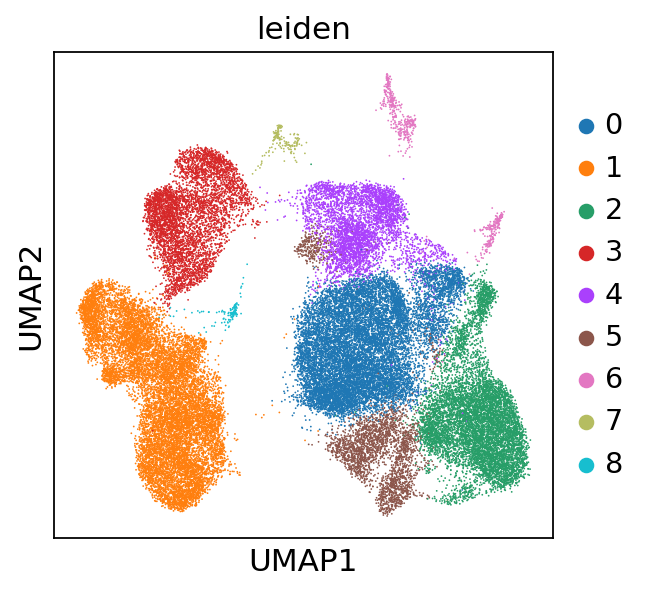

In [205]:
import matplotlib as mpl
#sc.pl.umap(cell_adata_mrnahv,color=['DROPTYPE', 'IND'])
#sc.pl.umap(cell_adata_mrnahv, color=['6','9','24'],  vmin=0, vmax=2, color_map=mpl.cm.viridis)
sc.pl.umap(cell_adata_mrnahv_fin, color=['leiden'], color_map=mpl.cm.Spectral_r, save="200204_200k_pbmc_RNA_leiden.png")

In [44]:
total_merge_df.shape

(47571, 28)

In [70]:
total_merge_df.head()

,CD45_merged,CD235_merged,CD61_merged,CD33_merged,CD3_merged,CD19_merged,CD117_merged,CD11b_merged,CD4_merged,CD8a_merged,...,PD-L1_merged,CD27_merged,CD45RO_merged,CCR7_merged,CD25_merged,TCR_Va24_Ja18_merged,CD38_merged,HLA_DR_merged,PD-1_merged,CD56_merged
AAACCCAAGAGGTATT-1,731.0,17.0,33.0,29.0,246.0,12.0,9.0,103.0,197.0,18.0,...,24.0,164.0,294.0,63.0,14.0,6.0,50.0,60.0,13.0,18.0
AAACCCAAGAGTGGCT-1,415.0,18.0,33.0,24.0,116.0,22.0,7.0,30.0,12.0,161.0,...,27.0,149.0,68.0,81.0,8.0,9.0,32.0,48.0,26.0,27.0
AAACCCAAGCGCACAA-1,1066.0,9.0,33.0,27.0,402.0,24.0,9.0,34.0,55.0,394.0,...,30.0,199.0,46.0,62.0,31.0,5.0,91.0,49.0,16.0,27.0
AAACCCAAGCGTCTCG-1,476.0,24.0,22.0,18.0,83.0,8.0,13.0,95.0,81.0,32.0,...,36.0,63.0,53.0,66.0,11.0,9.0,97.0,44.0,20.0,59.0
AAACCCAAGGAGCAAA-1,358.0,24.0,37.0,22.0,268.0,19.0,11.0,56.0,16.0,196.0,...,38.0,149.0,70.0,101.0,15.0,17.0,39.0,65.0,33.0,60.0


In [35]:
#adt_merged_adata = sc.AnnData(total_merge_df)
#sc.pp.normalize_per_cell(adt_merged_adata, counts_per_cell_after=1e4)
#sc.pp.log1p(adt_merged_adata)
#sc.pp.scale(adt_merged_adata, max_value=10)
#adt_merged_adata.var_names_make_unique()

normalizing by total count per cell
filtered out 1 cells that have less than 1 counts
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
    ... clipping at max_value 10


In [98]:
adt_merged_adata

AnnData object with n_obs × n_vars = 47570 × 28 
    obs: 'n_counts'
    uns: 'log1p'

In [99]:
cell_adata_mrnahv

AnnData object with n_obs × n_vars = 47571 × 1403 
    obs: 'DROPTYPE', 'IND', 'percent_mito', 'n_counts', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'
    uns: 'log1p', 'neighbors', 'leiden', 'umap', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'

In [206]:
#adt_merged_adata = sc.AnnData(total_merge_df)
cell_adata_mrnahv_fin.X = csr_matrix(cell_adata_mrnahv_fin.X) # need this to concatenate
cell_adata_test1 = cell_adata_mrnahv_fin.T.concatenate(adt_merged_adata.T).T.copy()

In [207]:
cell_adata_test1

AnnData object with n_obs × n_vars = 47570 × 2459 
    obs: 'DROPTYPE-0-0', 'IND-0-0', 'percent_mito-0-0', 'n_counts-1-0', 'n_counts-0', 'leiden-0', 'n_counts-1'
    var: 'batch', 'feature_types', 'gene_ids', 'genome', 'n_counts'

In [208]:
cell_adata_test1.uns = cell_adata_mrnahv_fin.uns # copy over the umap and leiden data
cell_adata_test1.obsm = cell_adata_mrnahv_fin.obsm # copy over the umap and leiden data

In [209]:
cell_adata_test1.var

,batch,feature_types,gene_ids,genome,n_counts
KLHL17-0-0,0,Gene Expression,ENSG00000187961,GRCh38,443.0
HES4-0-0,0,Gene Expression,ENSG00000188290,GRCh38,3458.0
ISG15-0-0,0,Gene Expression,ENSG00000187608,GRCh38,20265.0
C1orf159-0-0,0,Gene Expression,ENSG00000131591,GRCh38,930.0
TNFRSF18-0-0,0,Gene Expression,ENSG00000186891,GRCh38,2021.0
...,...,...,...,...,...
TCR_Va24_Ja18_merged-1,1,NaN,NaN,NaN,NaN
CD38_merged-1,1,NaN,NaN,NaN,NaN
HLA_DR_merged-1,1,NaN,NaN,NaN,NaN
PD-1_merged-1,1,NaN,NaN,NaN,NaN


... storing 'DROPTYPE-0-0' as categorical
... storing 'IND-0-0' as categorical
... storing 'leiden-0' as categorical
... storing 'feature_types' as categorical
... storing 'gene_ids' as categorical
... storing 'genome' as categorical


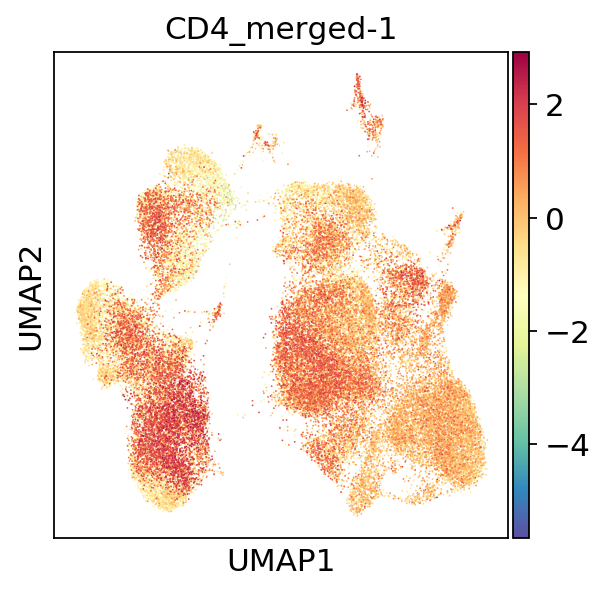

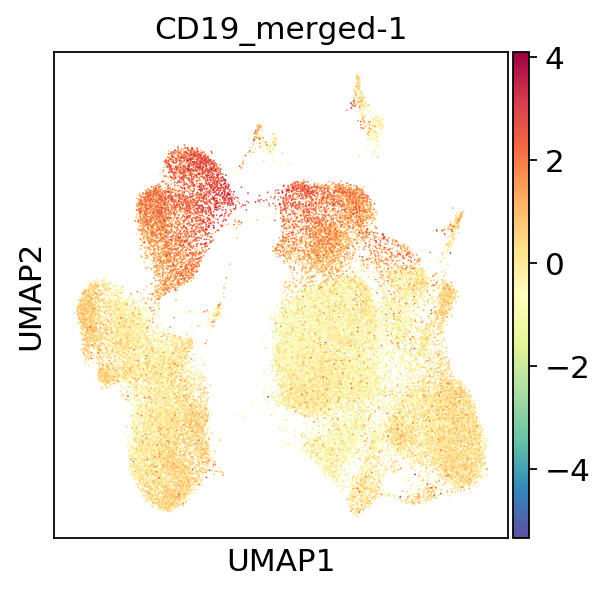

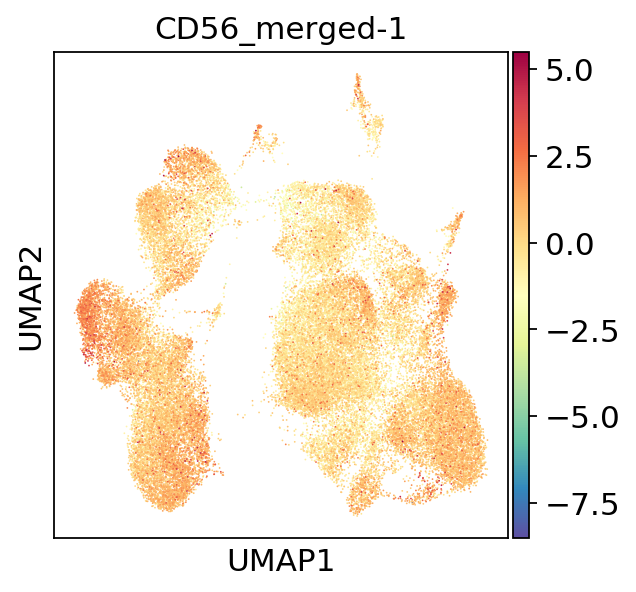

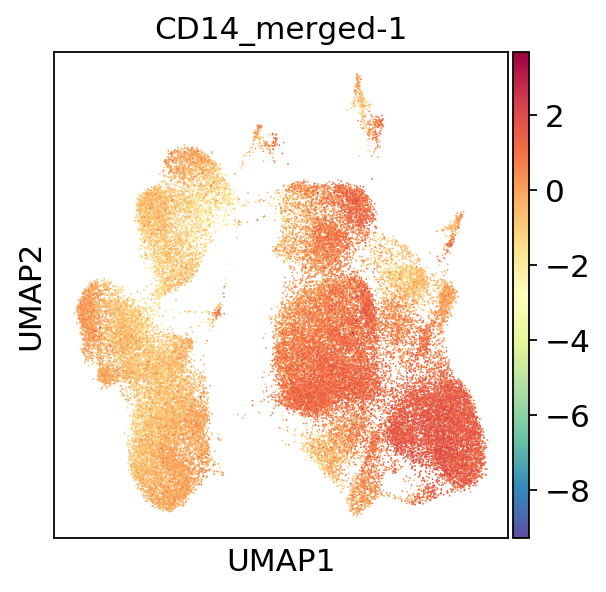

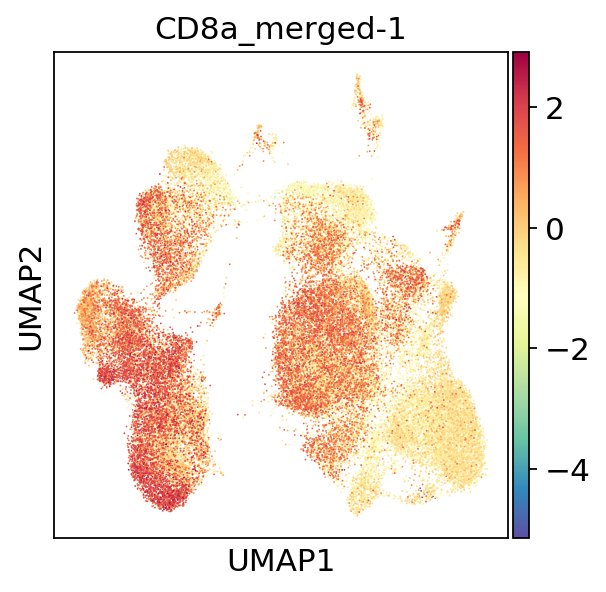

In [210]:
import matplotlib as mpl
sc.pl.umap(cell_adata_test1, color=['CD4_merged-1'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd4_RNA_umap.png")
sc.pl.umap(cell_adata_test1, color=['CD19_merged-1'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd19_RNA_umap.png")
sc.pl.umap(cell_adata_test1, color=['CD56_merged-1'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd56_RNA_umap.png")
sc.pl.umap(cell_adata_test1, color=['CD14_merged-1'],  color_map=mpl.cm.Spectral_r, save="200204_200k_cd14_RNA_umap.png")
sc.pl.umap(cell_adata_test1, color=['CD8a_merged-1'],  color_map=mpl.cm.Spectral_r, save="200204_200k_cd8a_RNA_umap.png")

# UMAP ADT before resolution using 28 merged ADT counts

In [211]:
adt_merged_adata2 = sc.AnnData(total_merge_df)
sc.pp.normalize_per_cell(adt_merged_adata2, counts_per_cell_after=1e4)
sc.pp.log1p(adt_merged_adata2)
sc.pp.scale(adt_merged_adata2, max_value=10)
adt_merged_adata2.var_names_make_unique()

normalizing by total count per cell
filtered out 1 cells that have less than 1 counts
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
    ... clipping at max_value 10


computing PCA with n_comps = 50
    reducing number of computed PCs to 27 as dim of data is only 28
    finished (0:00:00)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


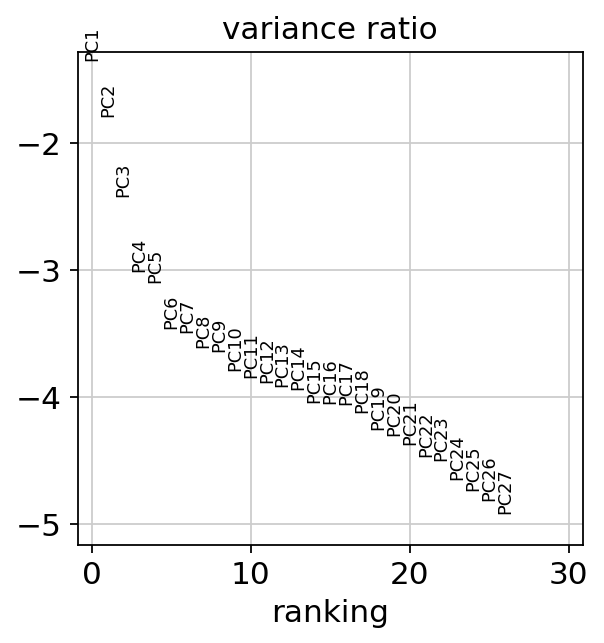

In [212]:
sc.tl.pca(adt_merged_adata2, svd_solver='arpack', use_highly_variable=None)
sc.pl.pca_variance_ratio(adt_merged_adata2, log=True)


In [213]:
sc.pp.neighbors(adt_merged_adata2, n_neighbors=10, n_pcs=15)
sc.tl.leiden(adt_merged_adata2,resolution=0.2)
sc.tl.umap(adt_merged_adata2)

computing neighbors
    computing neighbors
    using data matrix X directly


/home/bhwang1/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../home/bhwang1/anaconda3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/home/bhwang1/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../home/bhwang1/anaconda3/lib/python3.7/site-packag

    computed neighbors (0:00:08)
    computed connectivities (0:00:01)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:09)
running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:18)
computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:39)


In [214]:
ptn_names =pd.DataFrame(['CD45','CD234','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

adt_merged_adata2.var = ptn_names

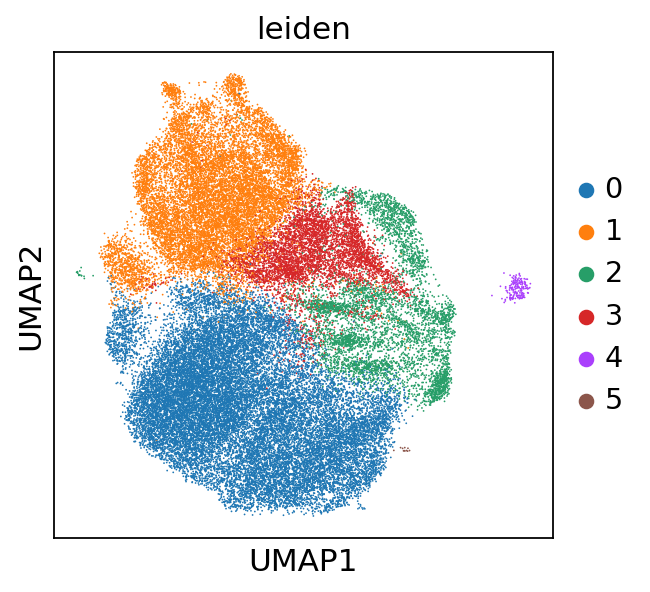

In [215]:
sc.pl.umap(adt_merged_adata2, color=['leiden'],   color_map=mpl.cm.Spectral_r, save="200204_200k_pbmc_adt_leiden.png")

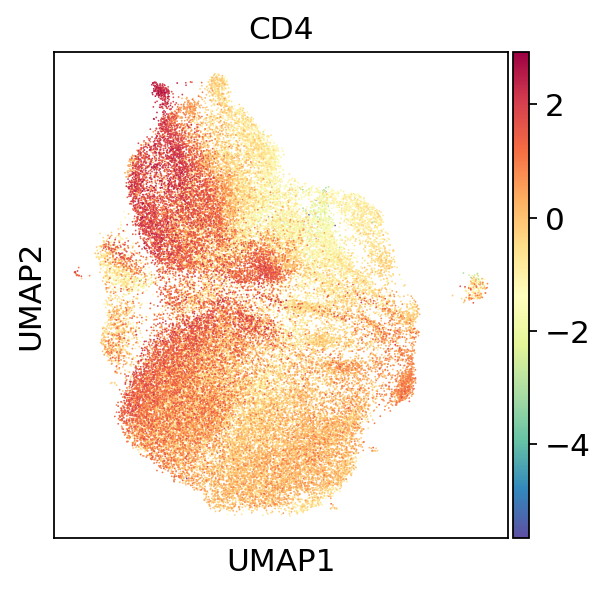

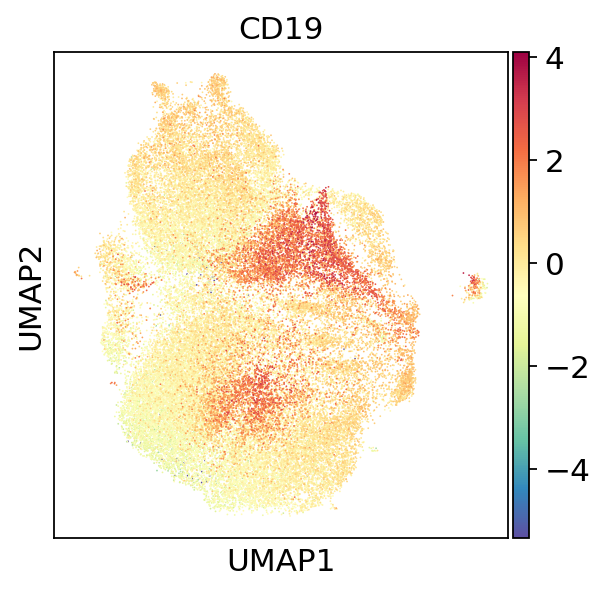

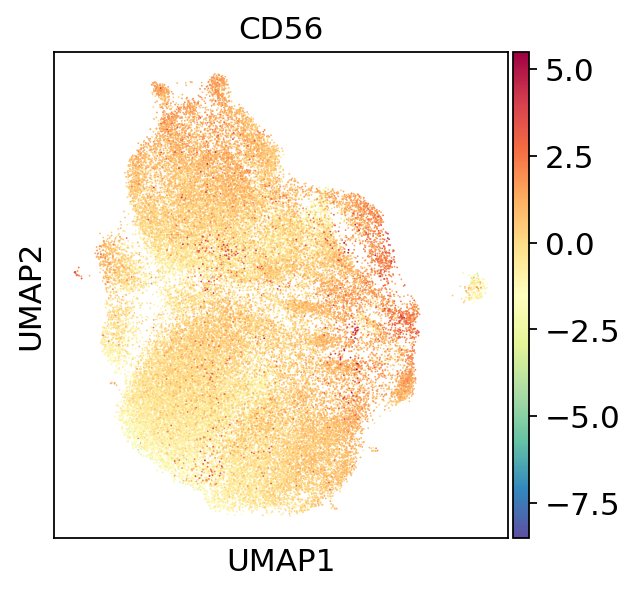

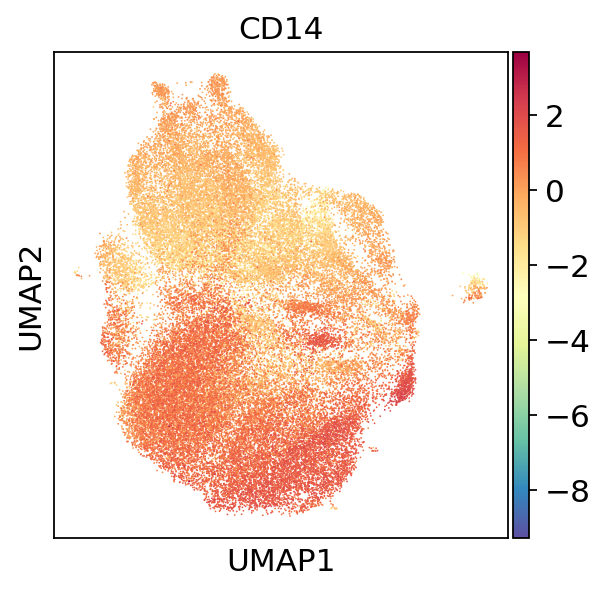

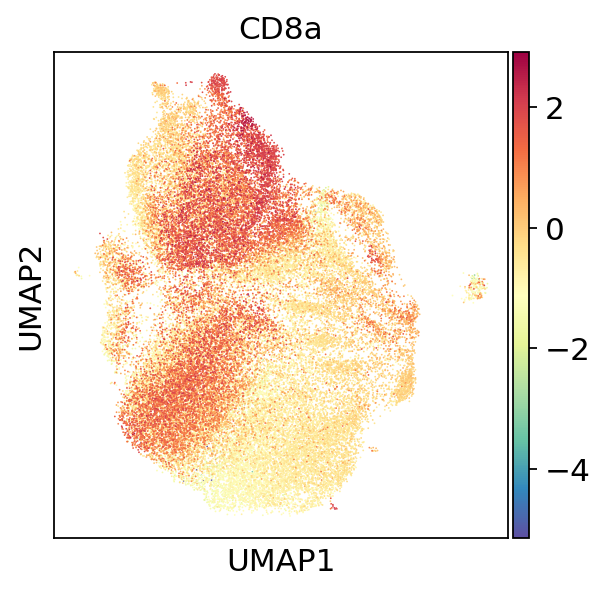

In [216]:
import matplotlib as mpl
#sc.pl.tsne(adt_resolved_adata)
sc.pl.umap(adt_merged_adata2, color=['CD4'], color_map=mpl.cm.Spectral_r, save="200204_200k_pbmc_cd4_adt_umap.png")
sc.pl.umap(adt_merged_adata2, color=['CD19'],  color_map=mpl.cm.Spectral_r, save="200204_200k_pbmc_cd19_adt_umap.png")
sc.pl.umap(adt_merged_adata2, color=['CD56'],  color_map=mpl.cm.Spectral_r, save="200204_200k_pbmc_cd56_adt_umap.png")
sc.pl.umap(adt_merged_adata2, color=['CD14'],   color_map=mpl.cm.Spectral_r, save="200204_200k_pbmc_cd14_adt_umap.png")
sc.pl.umap(adt_merged_adata2, color=['CD8a'],   color_map=mpl.cm.Spectral_r, save="200204_200k_pbmc_cd8a_adt_umap.png")

# UMAP based on HTOdemux R code final

In [25]:
meta_df = pd.read_table('/data/jupyter/200K_meta_ab_cell_matrix.txt',sep=',')
adt_df = pd.read_table('/data/jupyter/200K_selected_ab_cell_matrix.txt',sep=',')
            

In [26]:
meta_df.shape

(91381, 7)

In [27]:
adt_df.shape

(28, 91381)

In [28]:
meta_df.head()

,orig.ident,nCount_RNA,nFeature_RNA,Batch,Type,nCount_ADT,nFeature_ADT
X2,SeuratProject,984,24,Batch1,Doublet,984,24
X5,SeuratProject,872,28,Batch1,Singlet,872,28
X11,SeuratProject,1083,24,Batch1,Singlet,1083,24
X13,SeuratProject,1460,25,Batch1,Doublet,1460,25
X16,SeuratProject,1039,23,Batch1,Doublet,1039,23


In [29]:
adt_df.T.head()

,1,2,3,4,5,6,7,8,9,10,...,19,20,21,22,23,24,25,26,27,28
X2,295,1,11,0,252,2,1,1,38,1,...,2,108,5,7,2,0,20,4,1,3
X5,109,6,2,1,10,3,4,38,1,44,...,4,7,8,15,2,3,43,9,4,64
X11,296,0,30,0,5,4,3,51,0,3,...,3,1,10,12,2,3,18,4,2,18
X13,437,0,5,0,313,1,3,5,54,5,...,1,121,18,9,3,0,43,8,5,5
X16,189,3,3,0,9,11,0,6,0,3,...,1,11,16,9,1,3,192,72,1,4


In [30]:
#sc.tl.pca(adt_merged_adata, svd_solver='arpack', use_highly_variable=None)
#sc.pl.pca_variance_ratio(adt_merged_adata, log=True)

In [31]:
adt_from_R_adata = sc.AnnData(adt_df.T)
adt_from_R_adata.obs = meta_df
adt_from_R_adata.obs

sc.pp.normalize_per_cell(adt_from_R_adata, counts_per_cell_after=1e4)

Transforming to str index.


normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [32]:
batch1 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch1']
batch2 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch2']
batch3 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch3']
batch4 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch4']
batch5 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch5']
batch6 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch6']
batch7 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch7']
batch8 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch8']
batch9 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch9']
batch10 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch10']

sc.pp.log1p(batch1)
sc.pp.log1p(batch2)
sc.pp.log1p(batch3)
sc.pp.log1p(batch4)
sc.pp.log1p(batch5)
sc.pp.log1p(batch6)
sc.pp.log1p(batch7)
sc.pp.log1p(batch8)
sc.pp.log1p(batch9)
sc.pp.log1p(batch10)

sc.pp.scale(batch1, max_value=10)
sc.pp.scale(batch2, max_value=10)
sc.pp.scale(batch3, max_value=10)
sc.pp.scale(batch4, max_value=10)
sc.pp.scale(batch5, max_value=10)
sc.pp.scale(batch6, max_value=10)
sc.pp.scale(batch7, max_value=10)
sc.pp.scale(batch8, max_value=10)
sc.pp.scale(batch9, max_value=10)
sc.pp.scale(batch10, max_value=10)

per_batch_norm_from_R_adata = batch1.concatenate(batch2,batch3,batch4,batch5,batch6,batch7,batch8,batch9,batch10)

    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10


/home/bhwang1/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:298: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)


In [33]:
per_batch_norm_from_R_adata.var_names_make_unique()

computing PCA with n_comps = 50
    reducing number of computed PCs to 27 as dim of data is only 28
    finished (0:00:00)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


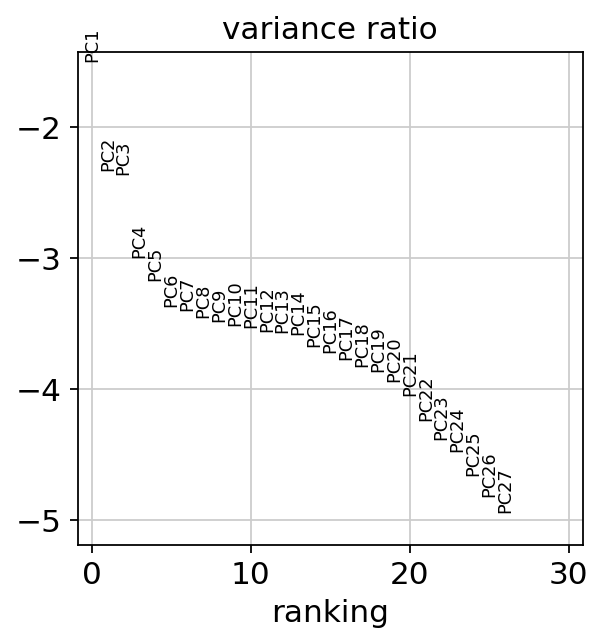

In [34]:
sc.tl.pca(per_batch_norm_from_R_adata, svd_solver='arpack', use_highly_variable=None)
sc.pl.pca_variance_ratio(per_batch_norm_from_R_adata, log=True)

In [35]:
sc.pp.neighbors(per_batch_norm_from_R_adata, n_neighbors=10, n_pcs=15)
sc.tl.leiden(per_batch_norm_from_R_adata,resolution=0.2)
sc.tl.umap(per_batch_norm_from_R_adata)

computing neighbors
    computing neighbors
    using data matrix X directly


/home/bhwang1/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../home/bhwang1/anaconda3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/home/bhwang1/anaconda3/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../home/bhwang1/anaconda3/lib/python3.7/site-package

    computed neighbors (0:00:22)
    computed connectivities (0:00:04)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:27)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:38)
computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:25)


In [36]:
ptn_names =pd.DataFrame(['CD45','CD235','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

per_batch_norm_from_R_adata.var = ptn_names

In [37]:
per_batch_norm_from_R_adata

AnnData object with n_obs × n_vars = 91381 × 28 
    obs: 'Batch', 'Type', 'batch', 'nCount_ADT', 'nCount_RNA', 'nFeature_ADT', 'nFeature_RNA', 'n_counts', 'orig.ident', 'leiden'
    uns: 'pca', 'neighbors', 'leiden', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

... storing 'Batch' as categorical
... storing 'Type' as categorical
... storing 'orig.ident' as categorical


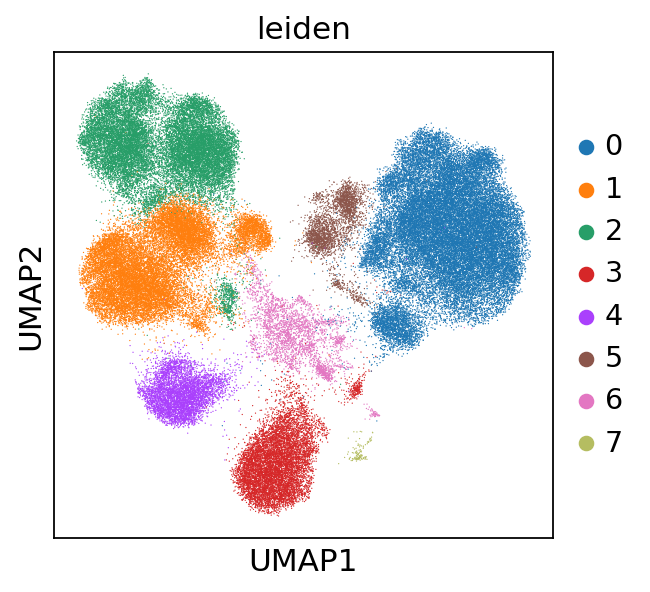

In [39]:
import matplotlib as mpl
sc.pl.umap(per_batch_norm_from_R_adata, color=['leiden'], color_map=mpl.cm.Spectral_r, save="200204_200k_resolved_leiden.png")

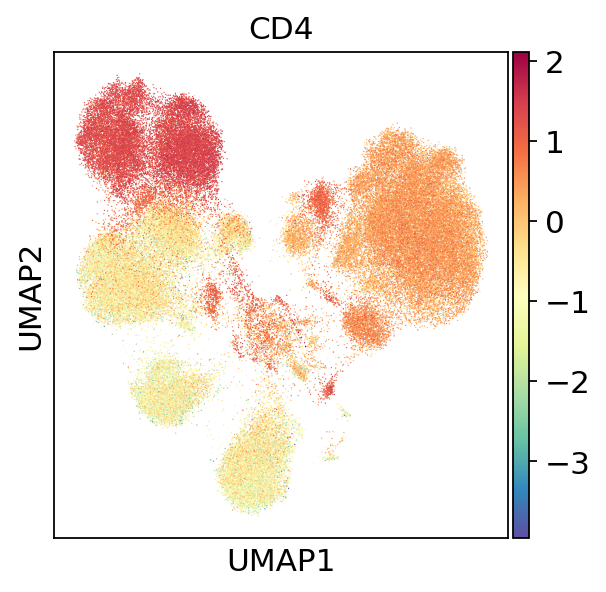

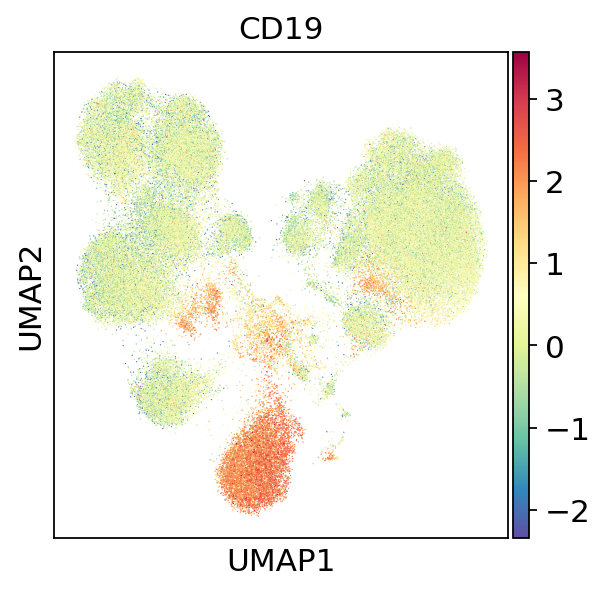

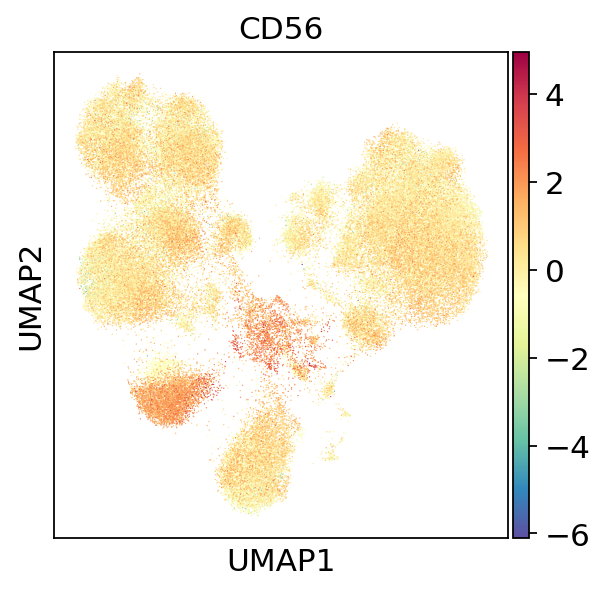

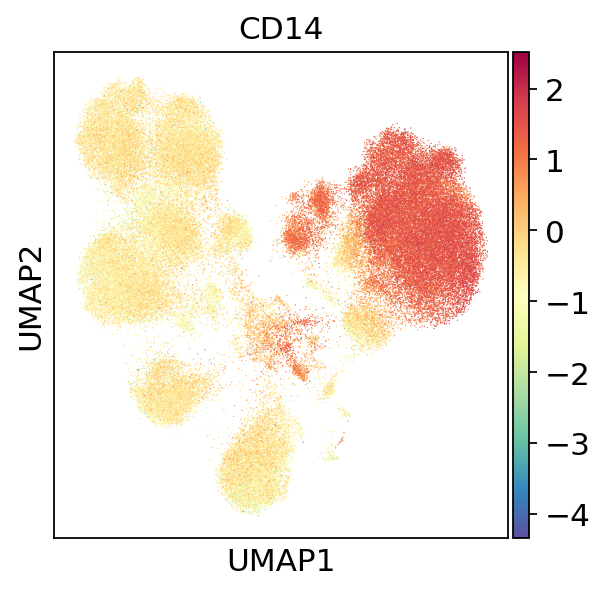

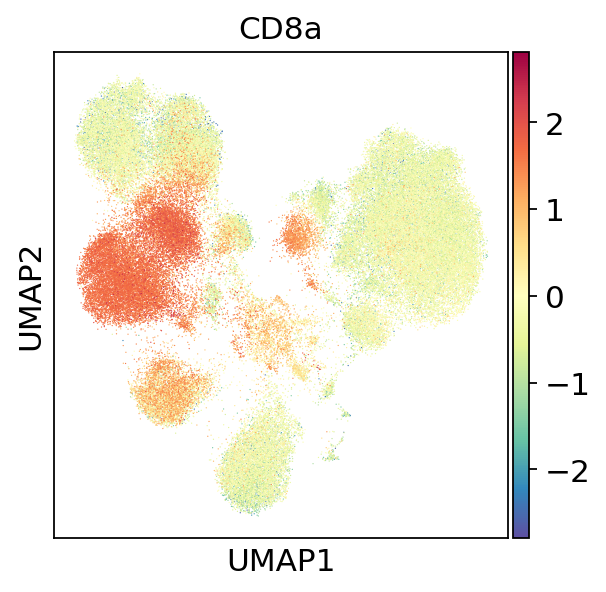

In [40]:
## import matplotlib as mpl
#sc.pl.umap(per_batch_norm_from_R_adata, color=['Batch'])
#sc.pl.tsne(adt_resolved_adata)
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD4'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd4_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD19'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd19_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD56'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd56_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD14'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd14_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD8a'], color_map=mpl.cm.Spectral_r, save="200204_200k_cd8a_resolved.png")

# UMAP for finding the cell type info

In [142]:
adt_df_negative = pd.read_table('/data/jupyter/200204_low_negatives_HTO_0.99.txt',sep=' ', header=None)

In [143]:
adt_df_negative.columns = ['cell', 'negatives']

In [144]:
adt_df_negative.head()

,cell,negatives
0,1,Negative
1,2,Doublet
2,3,Doublet
3,4,Negative
4,5,Negative


In [145]:
adt_df_negative.shape

(342860, 2)

In [146]:
adt_df = pd.read_csv('/data/jupyter/200204_pbmc_low_raw_for_umap_resolved_raw.txt',sep='\t', header=None)

In [147]:
adt_df_resolve_clean = adt_df.drop([28], axis=1)

In [148]:
adt_df_resolve_clean.shape

(342860, 28)

In [149]:
adt_df_resolve_clean.head()

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,2.0,2.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,2.0,...,0.0,0.0,5.0,5.0,1.0,0.0,0.0,1.0,0.0,0.0
1,457.0,1.0,0.0,3.0,128.0,2.0,3.0,2.0,4.0,36.0,...,3.0,1.0,49.0,4.0,0.0,0.0,4.0,1.0,6.0,3.0
2,769.0,3.0,32.0,43.0,1.0,0.0,2.0,608.0,25.0,6.0,...,3.0,2.0,464.0,13.0,1.0,0.0,33.0,43.0,2.0,7.0
3,5.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,3.0,...,1.0,2.0,0.0,1.0,0.0,1.0,1.0,4.0,1.0,0.0
4,8.0,1.0,2.0,4.0,4.0,3.0,2.0,0.0,1.0,3.0,...,2.0,2.0,0.0,11.0,3.0,2.0,5.0,1.0,0.0,0.0


# add negative classification from HTO demux from Seurat

In [150]:
adt_df_clean_resolved = adt_df_resolve_clean.join(adt_df_negative)

In [151]:
adt_df_clean_resolved['Batch'] = ['Pool1','Pool2','Pool3','Pool4','Pool5','Pool6','Pool7','Pool8','Pool9','Pool10']*34286
adt_df_clean_final = adt_df_clean_resolved[adt_df_clean_resolved['negatives'] != 'Negative']
adt_df_clean_final.head()
df_batch = adt_df_clean_final['Batch'] # add as obs later

adt_df_clean_final = adt_df_clean_final.drop(['cell', 'negatives', 'Batch'], axis=1)
adt_df_clean_final.shape

(60388, 28)

In [152]:
adt_resolved_adata = sc.AnnData(adt_df_clean_final)

Transforming to str index.


In [153]:
df_batch.shape
batch = pd.DataFrame(df_batch)
batch['Batch']
#batch = batch.astype(str)

1          Pool2
2          Pool3
13         Pool4
15         Pool6
18         Pool9
           ...  
342830     Pool1
342836     Pool7
342840     Pool1
342858     Pool9
342859    Pool10
Name: Batch, Length: 60388, dtype: object

In [154]:
batch2 = pd.DataFrame(batch['Batch'])
batch2.columns=['Pool']
#batch2 = batch2.set_index('Pool')

batch2['Pool'] = batch['Batch']
batch2['Batch'] = batch['Batch']
batch2 = batch2.set_index('Pool')

adt_resolved_adata.obs = batch2
batch1 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool1']
batch2 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool2']
batch3 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool3']
batch4 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool4']
batch5 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool5']
batch6 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool6']
batch7 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool7']
batch8 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool8']
batch9 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool9']
batch10 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool10']

sc.pp.log1p(batch1)
sc.pp.log1p(batch2)
sc.pp.log1p(batch3)
sc.pp.log1p(batch4)
sc.pp.log1p(batch5)
sc.pp.log1p(batch6)
sc.pp.log1p(batch7)
sc.pp.log1p(batch8)
sc.pp.log1p(batch9)
sc.pp.log1p(batch10)

sc.pp.scale(batch1, max_value=10)
sc.pp.scale(batch2, max_value=10)
sc.pp.scale(batch3, max_value=10)
sc.pp.scale(batch4, max_value=10)
sc.pp.scale(batch5, max_value=10)
sc.pp.scale(batch6, max_value=10)
sc.pp.scale(batch7, max_value=10)
sc.pp.scale(batch8, max_value=10)
sc.pp.scale(batch9, max_value=10)
sc.pp.scale(batch10, max_value=10)


/home/bhwang1/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:298: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, 

    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10
    ... clipping at max_value 10


In [155]:
per_batch_norm_adata = batch1.concatenate(batch2,batch3,batch4,batch5,batch6,batch7,batch8,batch9,batch10)
per_batch_norm_adata

Transforming to str index.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Or pass `index_unique!=None` to `.concatenate`.


AnnData object with n_obs × n_vars = 60388 × 28 
    obs: 'Batch', 'batch'

In [150]:
#sc.pp.normalize_per_cell(adt_resolved_adata, counts_per_cell_after=1e4)

In [151]:
sc.pp.log1p(adt_resolved_adata)

Extract out highly variable genes, but don't subset just yet.

In [455]:
#hv_out = sc.pp.highly_variable_genes(adt_resolved_adata, inplace=False)

extracting highly variable genes
    Gene indices [0, 2, 3, 9, 16, 22] fell into a single bin: their normalized dispersion was set to 1.
    Decreasing `n_bins` will likely avoid this effect.
    finished (0:00:00)


In [456]:
#adt_resolved_adata.var.tail(28)

In [457]:
#keep_genes = adt_resolved_adata.var_names[hv_out['highly_variable']].tolist()
#proteins = ['CD4_barcode1', 'CD19_barcode1', 'CD25_barcode1', 'CD56_barcode1']
# proteins = ['CD4-BC1', 'CD4-BC2', 'CD14-BC1', 'CD14-BC2']

Are our proteins highly variable?

In [458]:
#[i in keep_genes for i in proteins]

Regress out unwanted variation.

In [459]:
#cell_adata = cell_adata[:,keep_genes + proteins].copy()

In [460]:
#sc.pp.regress_out(cell_adata,['percent_mito','n_counts'],n_jobs=40)

# need to write function per batch norm

In [137]:
sc.pp.scale(adt_resolved_adata, max_value=10)

    ... clipping at max_value 10


In [138]:
adt_resolved_adata.var_names_make_unique()

In [156]:
per_batch_norm_adata.var_names_make_unique()

In [49]:
#len(keep_genes)

Cluster on just the mRNA and then we'll add our protein markers back later.

In [464]:
#cell_adata_mrnahv = cell_adata[:,keep_genes].copy()
#cell_adata_p = cell_adata[:,proteins].copy()

Begin clustering and dimensionality reduction.

In [157]:
sc.tl.pca(per_batch_norm_adata, svd_solver='arpack', use_highly_variable=None)

computing PCA with n_comps = 50
    reducing number of computed PCs to 27 as dim of data is only 28
    finished (0:00:00)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


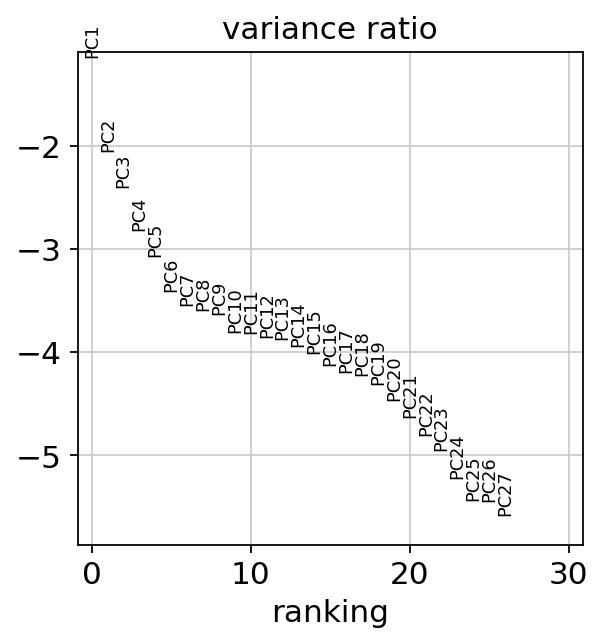

In [158]:
sc.pl.pca_variance_ratio(per_batch_norm_adata, log=True)

In [159]:
sc.pp.neighbors(per_batch_norm_adata, n_neighbors=10, n_pcs=15)

computing neighbors
    computing neighbors
    using data matrix X directly


/home/bhwang1/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../home/bhwang1/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    computed neighbors (0:00:11)
    computed connectivities (0:00:01)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:12)


In [160]:
sc.tl.leiden(per_batch_norm_adata,resolution=0.2)
#sc.tl.louvain(adt_resolved_adata,resolution=0.2)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:16)


In [161]:
sc.tl.umap(per_batch_norm_adata)
#sc.api.tl.tsne(adt_resolved_adata, n_pcs=15, n_jobs=30)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:50)


In [162]:
ptn_names =pd.DataFrame(['CD45','CD234','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

per_batch_norm_adata.var = ptn_names

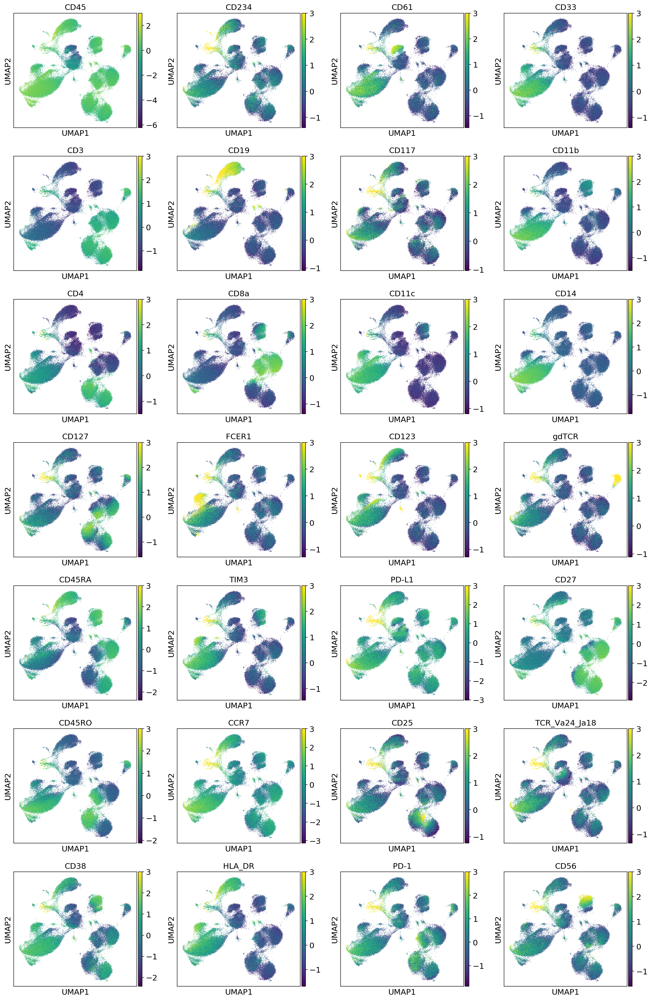

In [165]:
import matplotlib as mpl
#sc.pl.tsne(adt_resolved_adata)
sc.pl.umap(per_batch_norm_adata, color=['CD45','CD234','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'], vmax=3,  color_map=mpl.cm.viridis)

In [398]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(adt_resolved_adata,n_neighbors=10) # numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using data matrix X directly
    computed neighbors (0:00:15)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:17)


In [399]:
# resolution to 0.2 for small number of clusters 
sc.tl.leiden(adt_resolved_adata,resolution=0.7)

running Leiden clustering
    finished: found 25 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:45)


In [400]:
sc.tl.umap(adt_resolved_adata,min_dist=2,gamma=50)

computing UMAP


/home/bhwang1/anaconda3/lib/python3.7/site-packages/umap/umap_.py:1052: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:13)


In [418]:
ptn_names =pd.DataFrame(['CD45','CD234','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

adt_resolved_adata.var = ptn_names

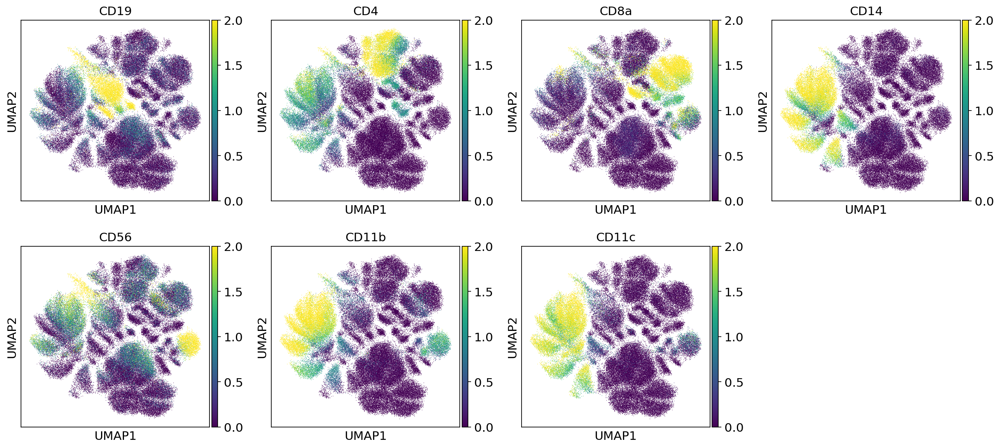

In [402]:
import matplotlib as mpl
#sc.pl.umap(adt_resolved_adata,color=['leiden'])
sc.pl.umap(adt_resolved_adata, color=['CD19','CD4','CD8a','CD14','CD56', 'CD11b','CD11c'],  vmin=0, vmax=2, color_map=mpl.cm.viridis)
#sc.pl.umap(cell_adata, color=['leiden', 'IL7R', 'MS4A1'])

In [39]:
new_cluster_names = ['CD4 T cells','B cells','Doublets','NA','NA2']
cell_adata_mrnahv.rename_categories('leiden', new_cluster_names)

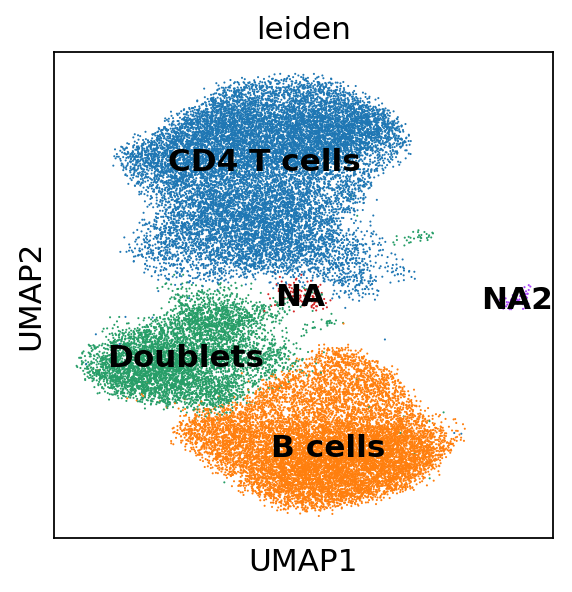

In [40]:
sc.pl.umap(cell_adata_mrnahv, color='leiden', legend_loc='on data')

In [41]:
df_cell_type = cell_adata_mrnahv.obs['leiden']

In [90]:
cell_adata_mrnahv

AnnData object with n_obs × n_vars = 16783 × 2901 
    obs: 'DROPTYPE', 'IND', 'percent_mito', 'n_counts', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'
    uns: 'neighbors', 'leiden', 'leiden_colors', 'DROPTYPE_colors', 'leiden-0_colors', 'DROPTYPE-0_colors', 'IND-0_colors'
    obsm: 'X_pca', 'X_umap'

Concatenate back the proteins with the mRNA.

In [115]:
cell_adata_mrnahv.X = csr_matrix(cell_adata_mrnahv.X) # need this to concatenate
cell_adata_comb = cell_adata_mrnahv.T.concatenate(cell_adata_p.T).T.copy()# concatenate along the variables axis

In [56]:
a=ctype_gmm_df['CD4barcode1'].to_frame()
b=ctype_gmm_df['CD4barcode2'].to_frame()
c=ctype_gmm_df['CD20barcode1'].to_frame()
d=ctype_gmm_df['CD20barcode2'].to_frame()
pgmm = a.join([b,c,d])
#pgmm.columns=['CD4barcode1','CD4barcode2','CD20barcode1','CD20barcode2']
pgmm_adata = sc.AnnData(pgmm)

In [57]:
pgmm.head()

,CD4barcode1,CD4barcode2,CD20barcode1,CD20barcode2
AAACCCAAGAAGCGAA-1,4.248160,-1.966288,0.316728,-2.454797
AAACCCAAGAATCTAG-1,-4.662562,1.134034,-4.123538,-4.358840
AAACCCAAGAGATGCC-1,3.145348,-4.045651,-4.708078,-3.481401
AAACCCAAGCCTAGGA-1,3.678950,-0.594339,-0.530931,4.432824
AAACCCAAGCTGCCAC-1,-3.115948,-1.529570,-3.192746,3.572544


# concatenate back the proteins with GMM normalized ADT counts

In [58]:
cell_adata_mrnahv.X = csr_matrix(cell_adata_mrnahv.X) 
cell_adata_comb = cell_adata_mrnahv.T.concatenate(pgmm_adata.T).T.copy()

Keep all the nice unstructured (uns) data and multi-D annotations of observations (obsm).

In [118]:
cell_adata_comb.uns = cell_adata_mrnahv.uns # copy over the umap and leiden data
cell_adata_comb.obsm = cell_adata_mrnahv.obsm # copy over the umap and leiden data

In [119]:
cell_adata_comb.obs.columns

Index(['n_counts', 'leiden-0'], dtype='object')

In [128]:
cell_adata_comb.var.tail(40)

,batch,feature_types,gene_ids,genome
CD45RA_barcode9-0,0,Antibody Capture,Ab9CD45RA,
TIM3_barcode9-0,0,Antibody Capture,Ab9TIM3,
PDL1_barcode9-0,0,Antibody Capture,Ab9PDL1,
CD45RO_barcode9-0,0,Antibody Capture,Ab9CD45RO,
CD25_barcode9-0,0,Antibody Capture,Ab9CD25,
TCR_Va24-Ja18_barcode9-0,0,Antibody Capture,Ab9TCR_Va24-Ja18,
CD38_barcode9-0,0,Antibody Capture,Ab9CD38,
HLA_DR_barcode9-0,0,Antibody Capture,Ab9HLA_DR,
PD-1_barcode9-0,0,Antibody Capture,Ab9PD-1,
CD56_barcode9-0,0,Antibody Capture,Ab9CD56,


Do some cleanup.

In [81]:
# cell_adata_comb.obs.drop(['DROPTYPE-1','IND-1'],axis=1,inplace=True) # clean up the obs
cell_adata_comb.obs.columns = ['DROPTYPE-0','IND-0','percent_mito','n_counts','leiden-0','DROPTYPE-1', 'IND-1'] # clean up the obs

In [82]:
cell_adata_comb.var_names = cell_adata_mrnahv.var_names.tolist() + cell_adata_p.var_names.tolist() # clean up those var names

Visualize!

... storing 'DROPTYPE-0' as categorical
... storing 'IND-0' as categorical
... storing 'leiden-0' as categorical
... storing 'feature_types' as categorical
... storing 'gene_ids' as categorical
... storing 'genome' as categorical


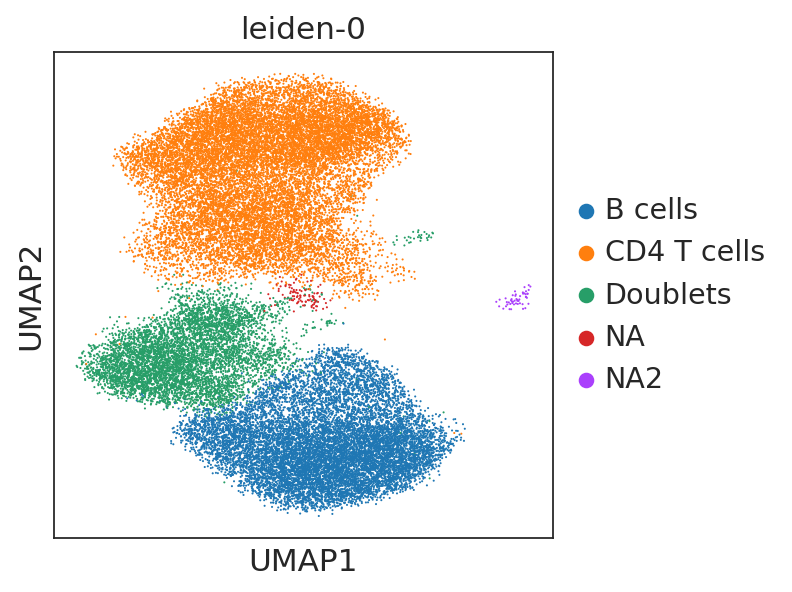

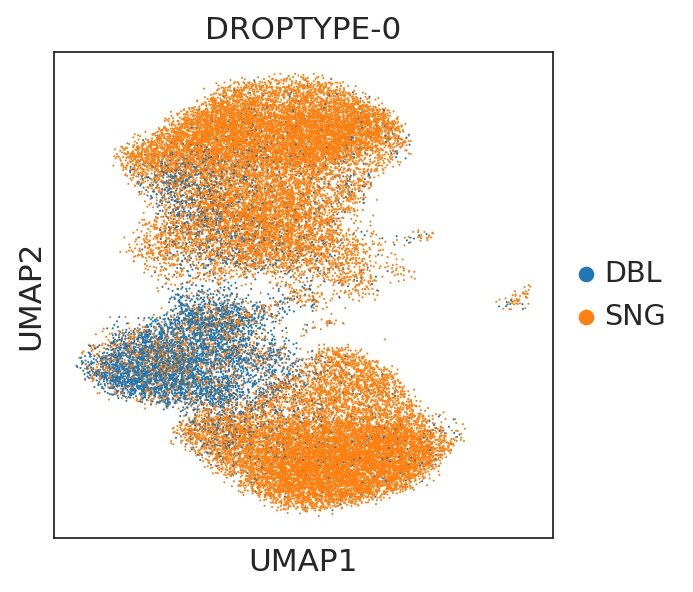

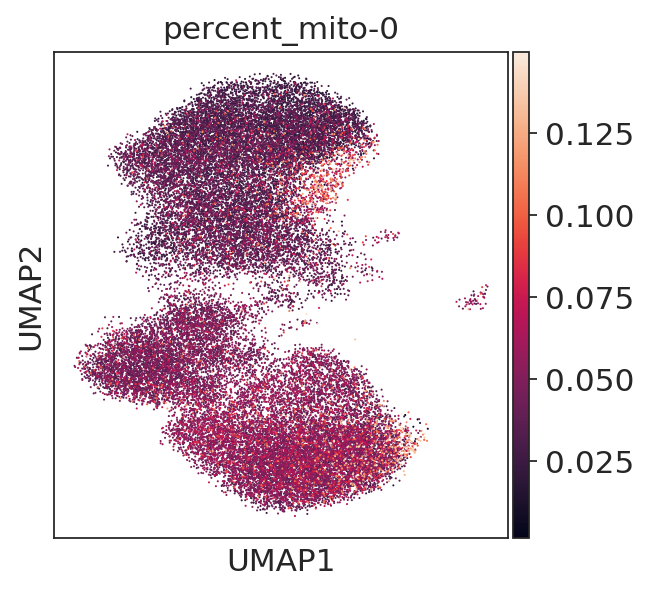

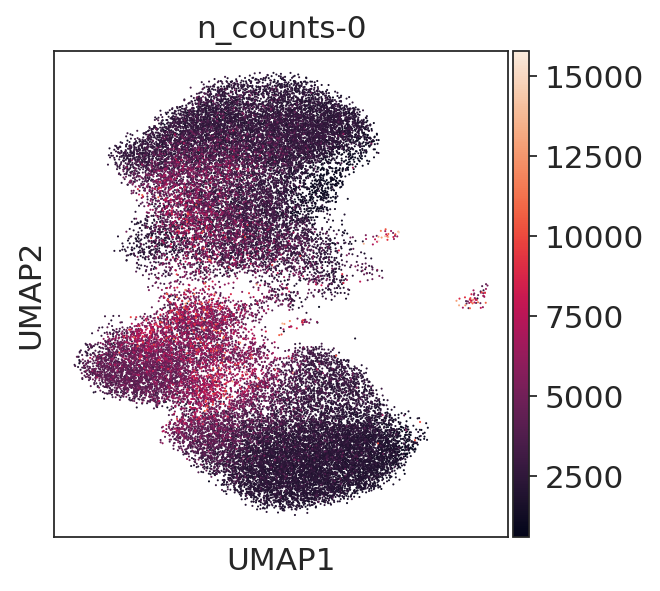

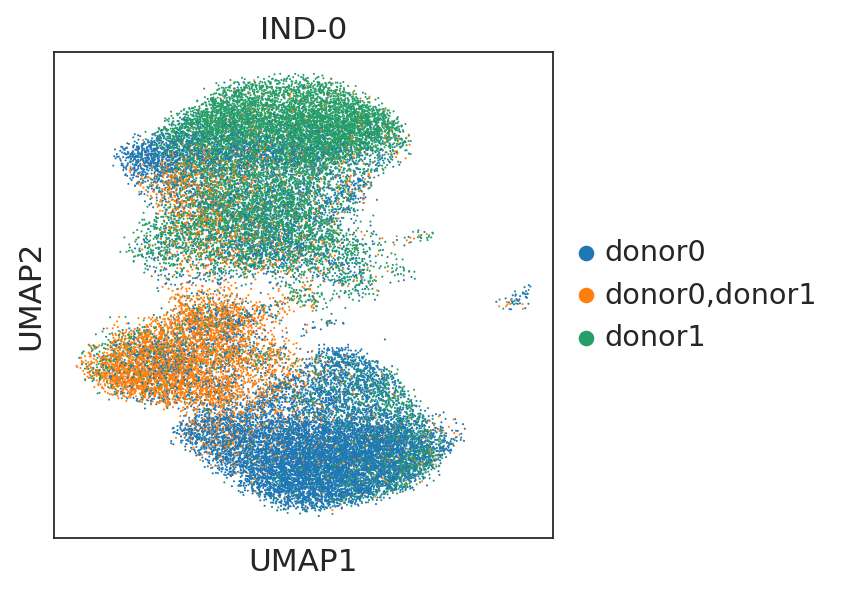

In [61]:
sc.pl.umap(cell_adata_comb,color='leiden-0')
sc.pl.umap(cell_adata_comb,color='DROPTYPE-0')
sc.pl.umap(cell_adata_comb,color='percent_mito-0')
sc.pl.umap(cell_adata_comb,color='n_counts-0')
sc.pl.umap(cell_adata_comb,color='IND-0')

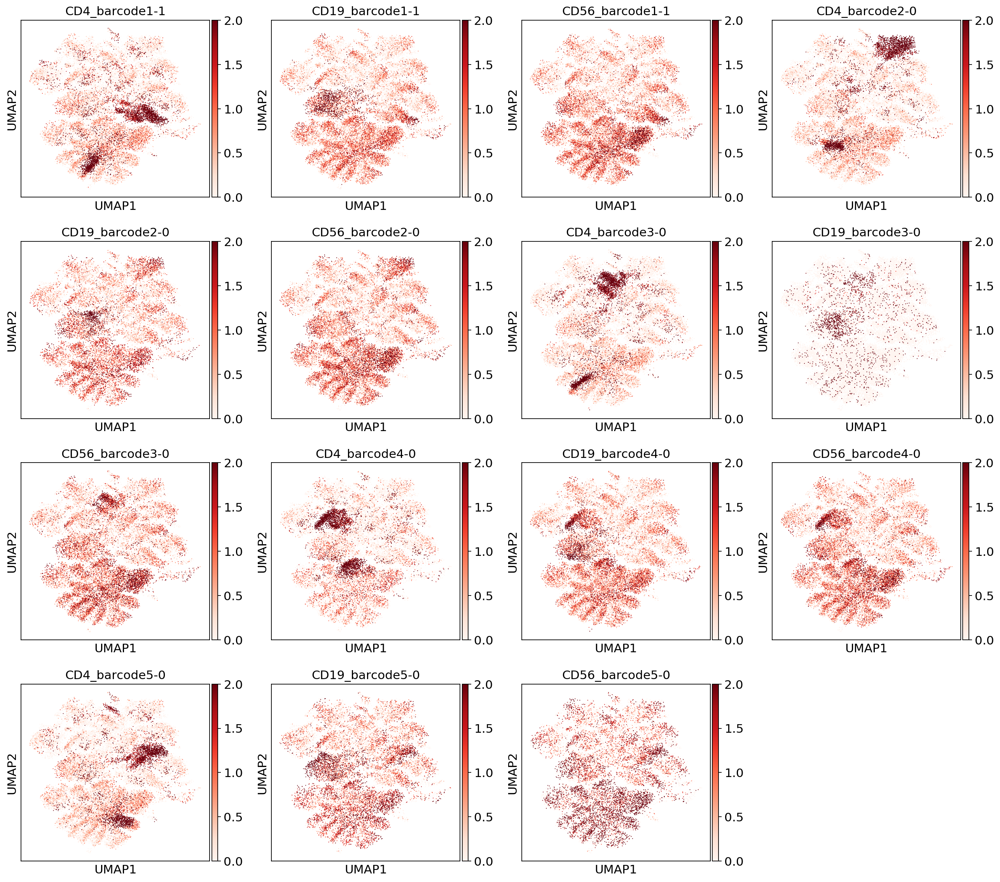

In [135]:
import matplotlib as mpl
sc.pl.umap(cell_adata_comb,color=['CD4_barcode1-1','CD19_barcode1-1', 'CD56_barcode1-1', 'CD4_barcode2-0','CD19_barcode2-0', 'CD56_barcode2-0', 'CD4_barcode3-0','CD19_barcode3-0', 'CD56_barcode3-0', 'CD4_barcode4-0','CD19_barcode4-0', 'CD56_barcode4-0', 'CD4_barcode5-0','CD19_barcode5-0', 'CD56_barcode5-0'], vmin=0, vmax=2, palette="Set2", color_map=mpl.cm.Reds)

In [43]:
cell_adata_comb_donor0 = cell_adata_comb[cell_adata_comb.obs['IND-0']=='donor0']
cell_adata_comb_donor1 = cell_adata_comb[cell_adata_comb.obs['IND-0']=='donor1']

In [183]:
cd3_1_donor1 = cell_adata_comb_donor1[:,'CD3barcode1'].X
cd20_1_donor1 = cell_adata_comb_donor1[:,'CD20barcode1'].X
cd3_1_donor0 = cell_adata_comb_donor0[:,'CD3barcode2'].X
cd20_1_donor0 = cell_adata_comb_donor0[:,'CD20barcode2'].X

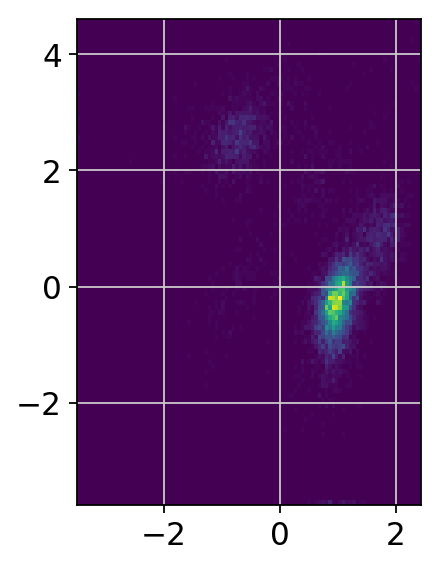

In [184]:
import numpy as np
import numpy.random
import matplotlib.pyplot as plt
# Generate some test data
x = cd3_1_donor1
y = cd20_1_donor1
heatmap, xedges, yedges = np.histogram2d(x, y, bins=100)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
plt.clf()
plt.imshow(heatmap.T, extent=extent, origin='lower')
plt.show()

In [50]:
sc.tl.embedding_density(cell_adata_comb_donor1, basis='umap', groupby=None, key_added='density', components=None)
sc.tl.embedding_density(cell_adata_comb_donor0, basis='umap', groupby=None, key_added='density', components=None)

computing density on 'umap'
--> added
    'density', densities (adata.obs)
    'density_params', parameter (adata.uns)
computing density on 'umap'
--> added
    'density', densities (adata.obs)
    'density_params', parameter (adata.uns)


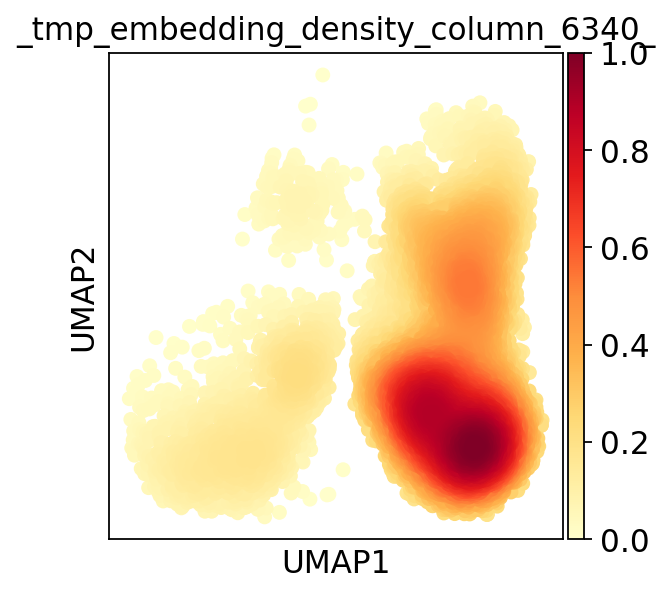

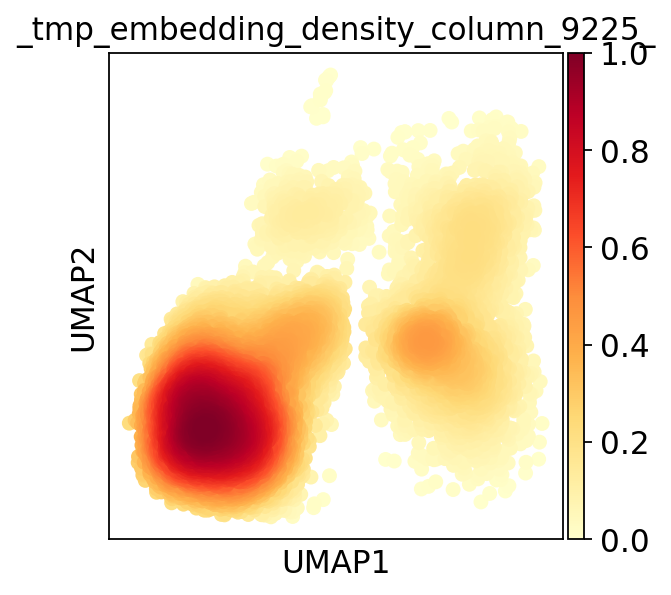

In [51]:
sc.pl.embedding_density(cell_adata_comb_donor1, basis='umap', key='density', group='all', color_map='YlOrRd', bg_dotsize=80, fg_dotsize=180, vmax=1, vmin=0, ncols=4, hspace=0.25, wspace=None, title=None, show=None, save=None, ax=None, return_fig=None)
sc.pl.embedding_density(cell_adata_comb_donor0, basis='umap', key='density', group='all', color_map='YlOrRd', bg_dotsize=80, fg_dotsize=180, vmax=1, vmin=0, ncols=4, hspace=0.25, wspace=None, title=None, show=None, save=None, ax=None, return_fig=None)

In [85]:
#plt.hist([cell_adata_comb_donor1[:,'CD20barcode1'].X], bins = 200, histtype='barstacked')

In [86]:
#plt.hist([cell_adata_comb_donor0[:,'CD20barcode2'].X], bins = 200, histtype='barstacked')

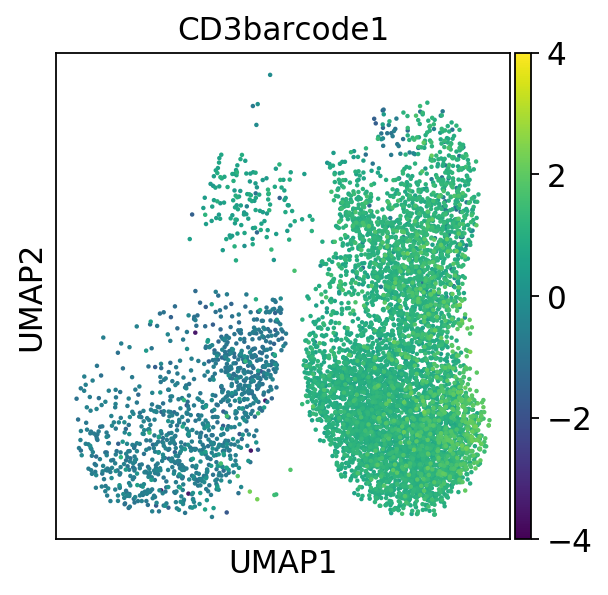

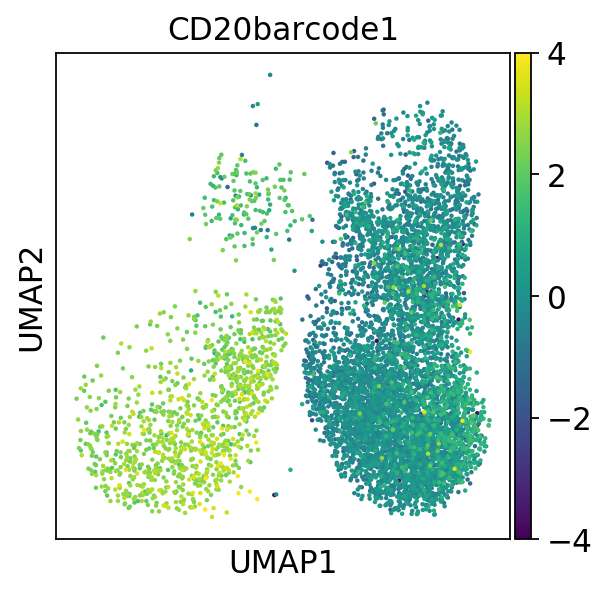

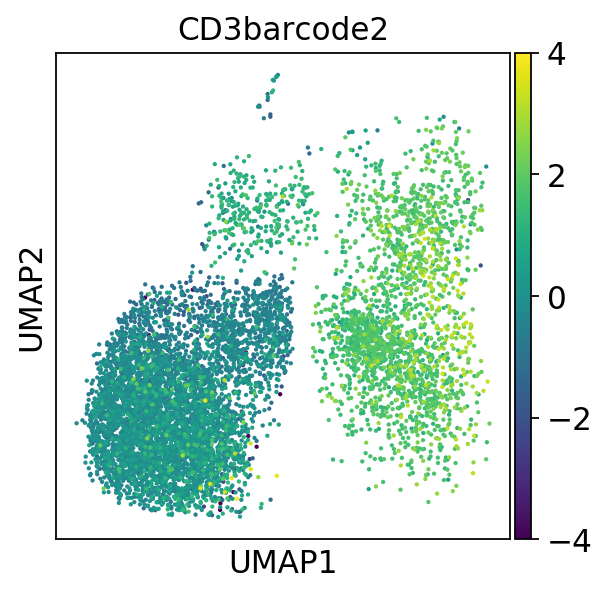

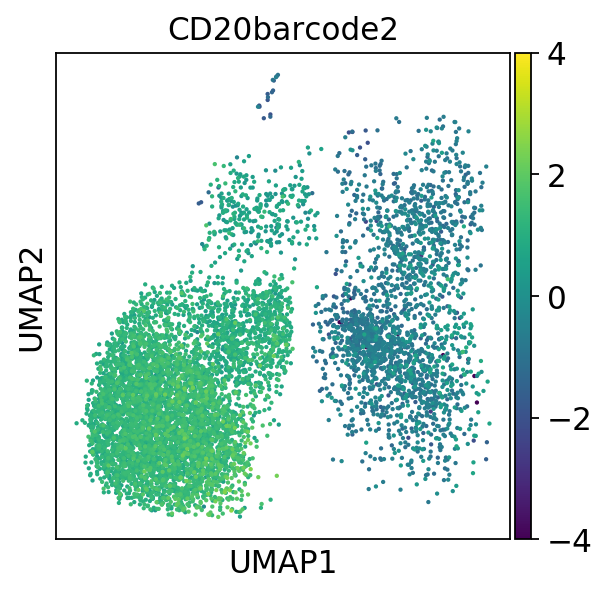

In [58]:
sc.pl.umap(cell_adata_comb_donor1,color='CD3barcode1', vmin=-4, vmax=4)
sc.pl.umap(cell_adata_comb_donor1,color='CD20barcode1', vmin=-4, vmax=4)
sc.pl.umap(cell_adata_comb_donor0,color='CD3barcode2', vmin=-4, vmax=4)
sc.pl.umap(cell_adata_comb_donor0,color='CD20barcode2', vmin=-4, vmax=4)

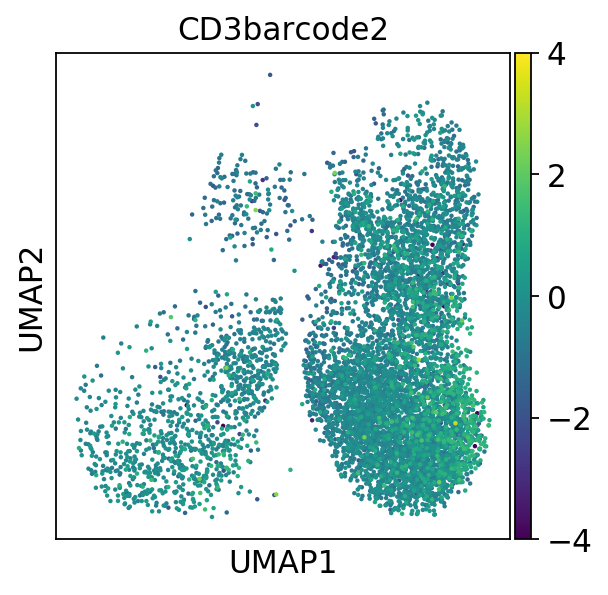

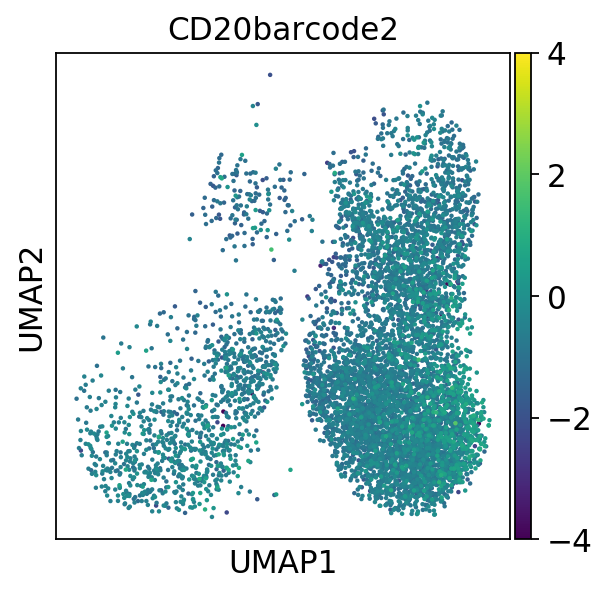

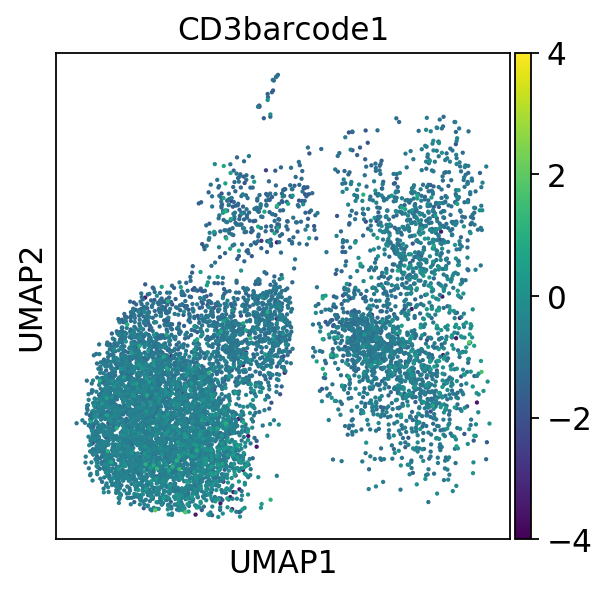

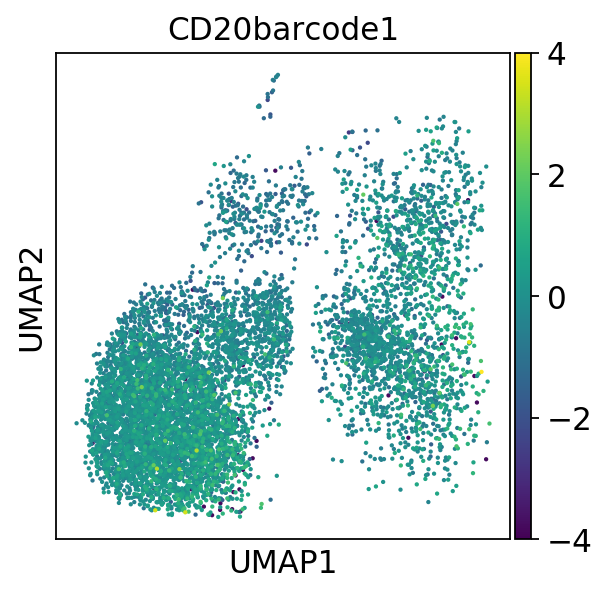

In [59]:
sc.pl.umap(cell_adata_comb_donor1,color='CD3barcode2', vmin=-4, vmax=4)
sc.pl.umap(cell_adata_comb_donor1,color='CD20barcode2', vmin=-4, vmax=4)
sc.pl.umap(cell_adata_comb_donor0,color='CD3barcode1', vmin=-4, vmax=4)
sc.pl.umap(cell_adata_comb_donor0,color='CD20barcode1', vmin=-4, vmax=4)

Cluster based on only two individual

In [64]:
cell_adata_comb_two =cell_adata_comb_sng[(cell_adata_comb_sng.obs['IND']=='IGTB1921')|(cell_adata_comb_sng.obs['IND']=='IGTB1542')]
cell_adata_comb_two_TB = cell_adata_comb_two[(cell_adata_comb_two.obs['leiden-0']=='0')|(cell_adata_comb_two.obs['leiden-0']=='3')|(cell_adata_comb_two.obs['leiden-0']=='4')]

In [65]:
cell_adata_comb_two_TB

View of AnnData object with n_obs × n_vars = 1867 × 1417 
    obs: 'DROPTYPE', 'IND', 'percent_mito', 'n_counts', 'leiden-0'
    var: 'batch', 'feature_types', 'gene_ids', 'genome', 'n_counts'
    uns: 'neighbors', 'leiden'
    obsm: 'X_pca', 'X_umap'

Cluster again with these subset cells (T, B cells for two donors)

In [73]:
sc.pp.neighbors(cell_adata_comb_two_TB,n_neighbors=10)

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:00)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)


In [74]:
sc.tl.leiden(cell_adata_comb_two_TB,resolution=0.7)

running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [75]:
sc.tl.umap(cell_adata_comb_two_TB,min_dist=2,gamma=50)

computing UMAP
	completed  0  /  500 epochs


/netapp/home/mtphobbes/anaconda3/lib/python3.7/site-packages/umap/umap_.py:1052: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/netapp/home/mtphobbes/anaconda3/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


subset the object by donor here!

In [84]:
cell_adata_comb_two_TB_1542 =cell_adata_comb_two_TB[cell_adata_comb_two_TB.obs['IND']=='IGTB1542']
cell_adata_comb_two_TB_1921 =cell_adata_comb_two_TB[cell_adata_comb_two_TB.obs['IND']=='IGTB1921']

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


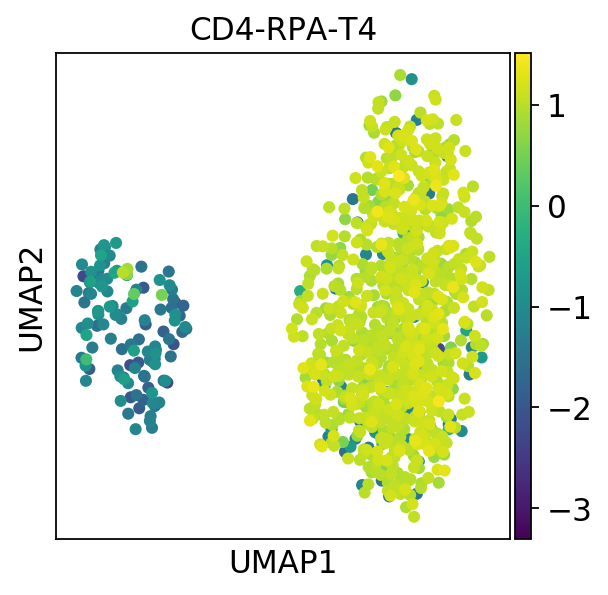

In [85]:
sc.pl.umap(cell_adata_comb_two_TB_1542,color=['CD4-RPA-T4'])

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


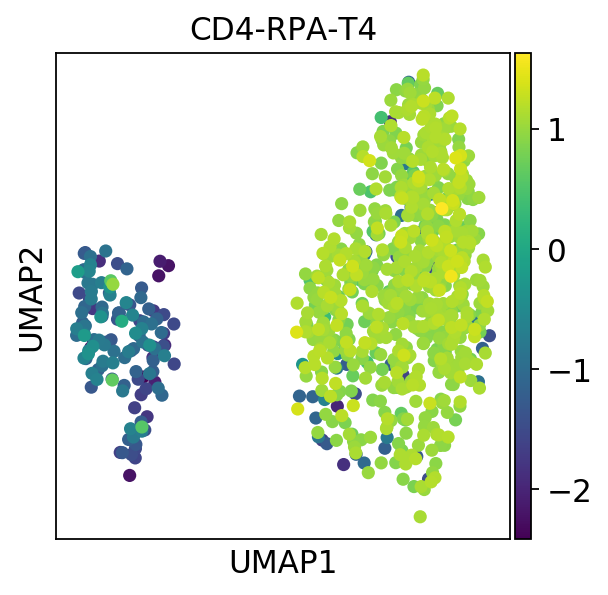

In [86]:
sc.pl.umap(cell_adata_comb_two_TB_1921,color=['CD4-RPA-T4'])

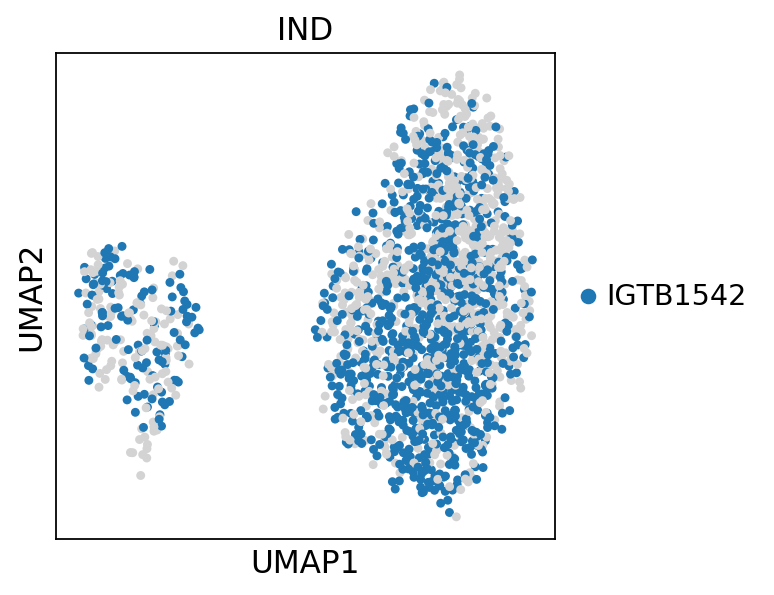

In [81]:
sc.pl.umap(cell_adata_comb_two_TB,color=['IND'], groups=['IGTB1542'])

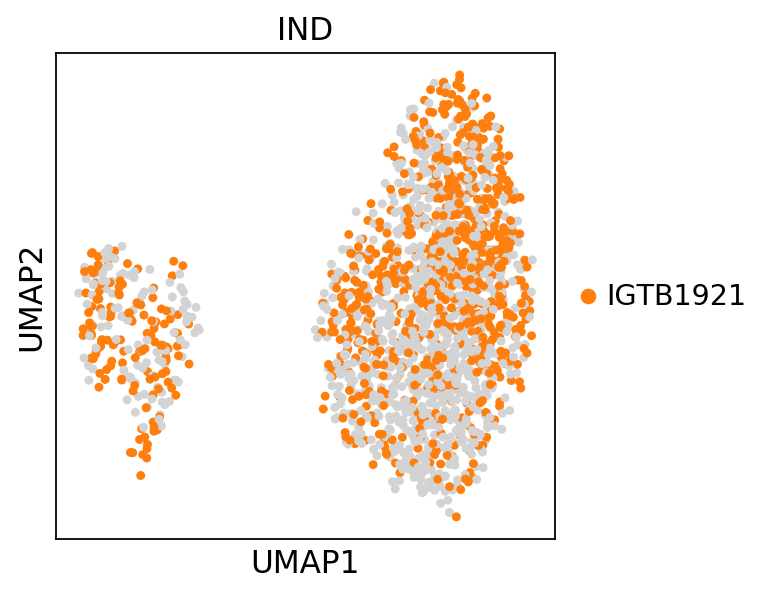

In [82]:
sc.pl.umap(cell_adata_comb_two_TB,color=['IND'], groups=['IGTB1921'])

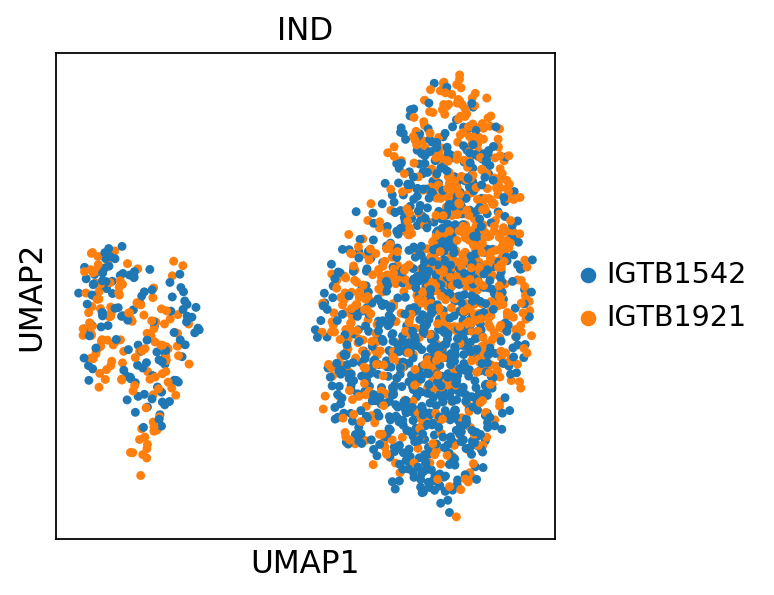

In [79]:
sc.pl.umap(cell_adata_comb_two_TB,color='IND')

In [45]:
cell_adata_mrnahv_two_TB.X = csr_matrix(cell_adata_mrnahv_two_TB.X) # need this to concatenate
cell_adata_comb_two_TB = cell_adata_mrnahv_two_TB.T.concatenate(cell_adata_p.T).T.copy()

Trying to set attribute `.X` of view, making a copy.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


ValueError: You're trying to transpose a view of an `AnnData`, which is currently not implemented. Call `.copy()` before transposing.

In [113]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(cell_adata_mrnahv_two,n_neighbors=10) # numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


        initialized `.distances` `.connectivities` 
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:00)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)


In [114]:
sc.tl.leiden(cell_adata_mrnahv_two,resolution=0.7)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [115]:
sc.tl.umap(cell_adata_mrnahv_two,min_dist=2,gamma=50)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed 

/netapp/home/mtphobbes/anaconda3/lib/python3.7/site-packages/umap/umap_.py:1052: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/netapp/home/mtphobbes/anaconda3/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


 100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)


In [117]:
cell_adata_mrnahv_two.X = csr_matrix(cell_adata_mrnahv_two.X) # need this to concatenate
cell_adata_two_comb = cell_adata_mrnahv_two.T.concatenate(cell_adata_p.T).T.copy()# concatenate along the variables axis

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Or pass `index_unique!=None` to `.concatenate`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [120]:
cell_adata_two_comb.uns = cell_adata_mrnahv_two.uns # copy over the umap and leiden data
cell_adata_two_comb.obsm = cell_adata_mrnahv_two.obsm # copy over the umap and leiden data

In [126]:
cell_adata_two_comb.obs

,DROPTYPE-0,IND-0,percent_mito,n_counts,leiden-0,DROPTYPE-1,IND-1
AAACCTGAGAGGTAGA-1,SNG,IGTB1921,0.014409,3470,3,SNG,IGTB1921
AAACCTGAGCCACTAT-1,SNG,IGTB1921,0.019268,3633,0,SNG,IGTB1921
AAACCTGCAGGAACGT-1,SNG,IGTB1921,0.019426,2368,0,SNG,IGTB1921
AAACCTGCATCCCACT-1,SNG,IGTB1921,0.036643,2729,5,SNG,IGTB1921
AAACCTGGTATATGAG-1,SNG,IGTB1921,0.009312,3544,0,SNG,IGTB1921
AAACCTGGTGACAAAT-1,SNG,IGTB1542,0.017643,3174,0,SNG,IGTB1542
AAACCTGGTTCTGGTA-1,SNG,IGTB1542,0.013936,4449,3,SNG,IGTB1542
AAACCTGTCCTAAGTG-1,SNG,IGTB1542,0.021837,2885,0,SNG,IGTB1542
AAACCTGTCGTAGATC-1,SNG,IGTB1542,0.044613,3295,7,SNG,IGTB1542
AAACCTGTCTCCGGTT-1,SNG,IGTB1921,0.009603,3124,0,SNG,IGTB1921


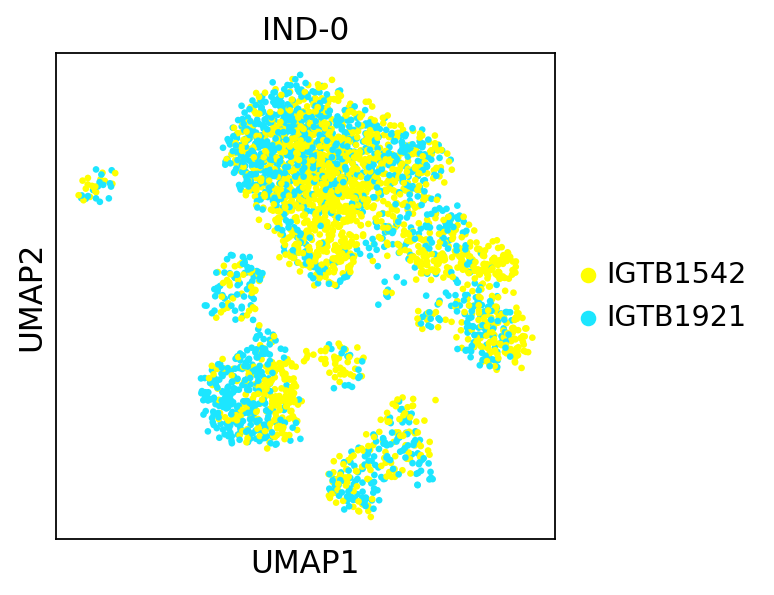

In [139]:
sc.pl.umap(cell_adata_two_comb,color='IND-0')

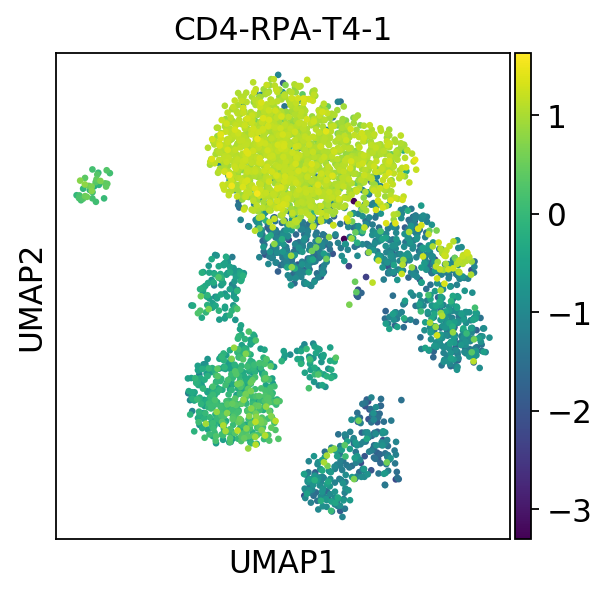

In [125]:
sc.pl.umap(cell_adata_two_comb,color='CD4-RPA-T4-1')

In [129]:
cell_adata_two_comb_sng_1921 = cell_adata_two_comb[cell_adata_two_comb.obs['IND-0']=='IGTB1921']
cell_adata_two_comb_sng_1542 = cell_adata_two_comb[cell_adata_two_comb.obs['IND-0']=='IGTB1542']

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


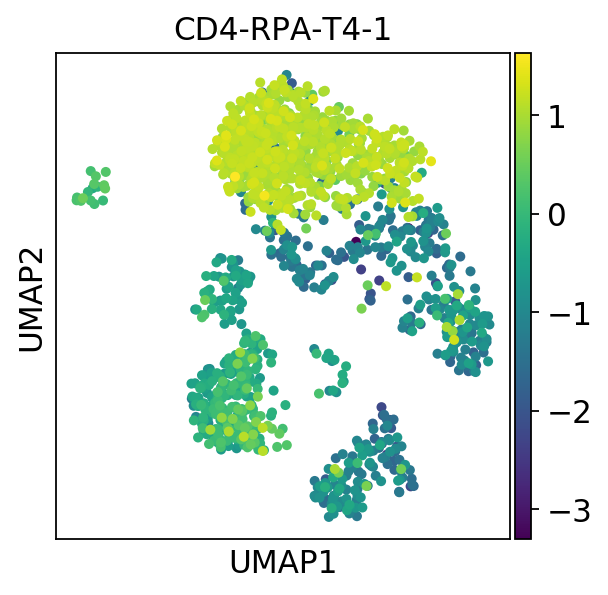

In [130]:
sc.pl.umap(cell_adata_two_comb_sng_1921,color='CD4-RPA-T4-1')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


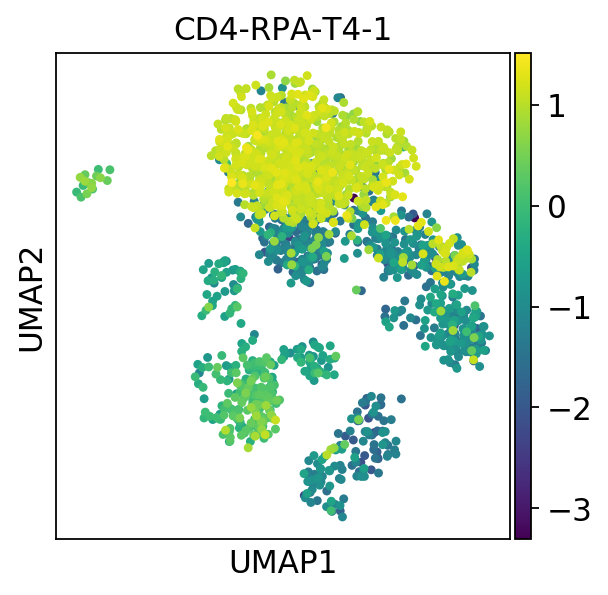

In [131]:
sc.pl.umap(cell_adata_two_comb_sng_1542,color='CD4-RPA-T4-1')

In [93]:
sc.tl.rank_genes_groups(cell_adata_comb,groupby='leiden')

ranking genes
    consider 'leiden' groups: ['0' '1' '2' '3' '4' '5' '6' '7' '8' '9' '10' '11']
    with sizes: [7863 7735 5052 4971 3826  240  187  180  107   62   53   42]


/usr/local/lib/python3.6/dist-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))
/usr/local/lib/python3.6/dist-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))
/usr/local/lib/python3.6/dist-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))
/usr/local/lib/python3.6/dist-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))
/usr/local/lib/python3.6/dist-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldc

    finished (0:00:19.06) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids


/usr/local/lib/python3.6/dist-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


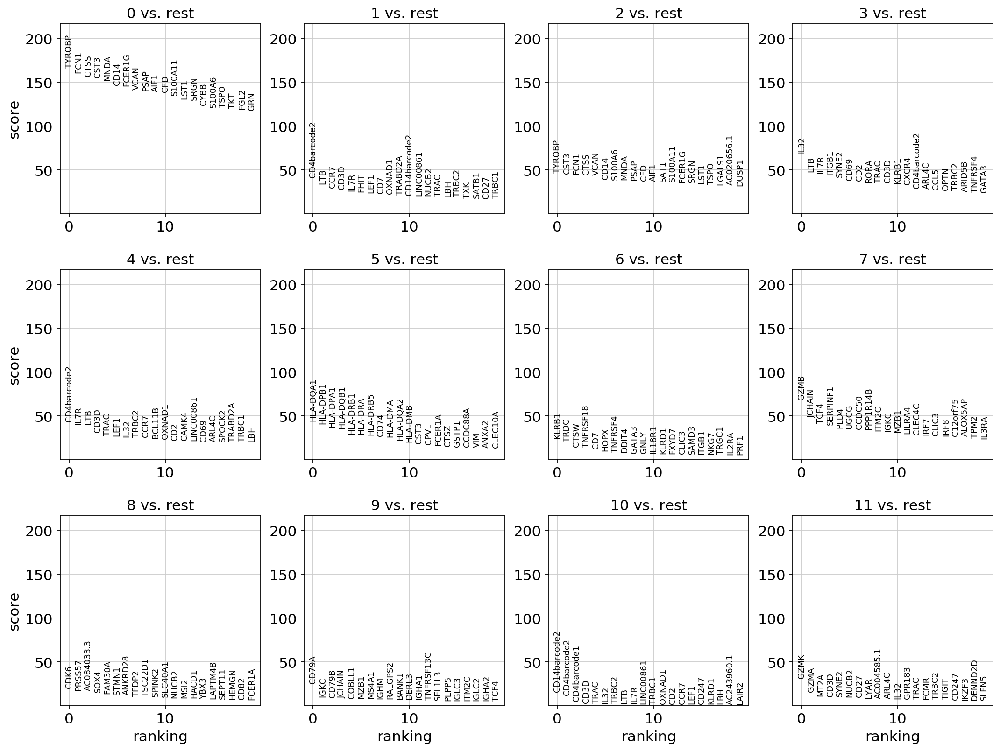

In [94]:
sc.pl.rank_genes_groups(cell_adata_comb,)

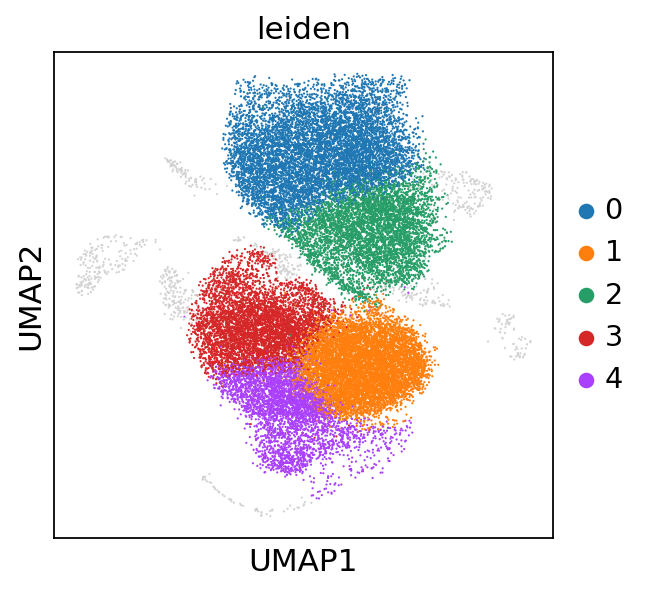

In [95]:
sc.pl.umap(cell_adata_comb,color=['leiden'],groups=[str(i) for i in range(0,5)])

In [96]:
cells_keep_core = cell_adata_comb[cell_adata_comb.obs['leiden'].astype(int) <= 4].obs_names

Going to save cells_keep and rerun a separate notebook with only these cells.

In [97]:
with open(prefix + 'cells.keep.core.txt','w') as file:
    [file.write(i + '\n') for i in cells_keep_core]

In [98]:
print(len(mymux.sngdbl()))
print(len(cell_adata_comb))
print(len(cells_keep_core))

31119
30318
29447
